## KPfrt Slc4a11-MCD/+ mice

Use control mice from Saline vs DT experiment

12/12/25 - Data pulled from GSE277777 (01_getData.ipynb)

In [1]:
import numpy as np
import pandas as pd
import scanpy as sc

import math
import matplotlib
from matplotlib import pyplot as plt

from pathlib import Path
import anndata

In [2]:
plt.rcParams['svg.fonttype'] = 'none'
plt.rcParams["font.family"] = "Arial"
#plt.rcParams['figure.figsize'] = (3,4)

In [3]:
sc.settings.verbosity = 3             # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_header()
sc.settings.set_figure_params(dpi=80, facecolor='white')
np.random.seed(1573)   #fix so we can reproduce later

In [4]:
#Path("./figures").mkdir(parents=True, exist_ok=True) # generate figures here
Path("./write").mkdir(parents=True, exist_ok=True) # write h5ad here

In [5]:
results_file = 'write/GSE277777_IGO15123_IGO15342_combined.h5ad'  # the file that will store the analysis results

In [6]:
adata1 = anndata.read_h5ad('GSE277777_allmice-tumor-IGO15123.h5ad')
adata2 = anndata.read_h5ad('GSE277777_allmice-tumor-IGO15342.h5ad')

In [7]:
adata = adata1.concatenate(adata2, join='inner', batch_categories=['First', 'Second'])
adata.uns['log1p'] = {}
adata.uns['log1p']['base'] = None

/tmp/ipykernel_2564523/2331359869.py:1: FutureWarning: Use anndata.concat instead of AnnData.concatenate, AnnData.concatenate is deprecated and will be removed in the future. See the tutorial for concat at: https://anndata.readthedocs.io/en/latest/concatenation.html
  adata = adata1.concatenate(adata2, join='inner', batch_categories=['First', 'Second'])


## Select saline control mice

In [8]:
adata = adata[adata.obs.Group == 'Saline',:]

## Set highly variable genes

In [9]:
sc.pp.highly_variable_genes(adata, batch_key='batch')

extracting highly variable genes
    finished (0:00:01)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


/home/chanj2/part2a/lib/python3.11/site-packages/scanpy/preprocessing/_highly_variable_genes.py:744: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns["hvg"] = {"flavor": flavor}


In [10]:
adata.var.highly_variable = adata.var.highly_variable_intersection

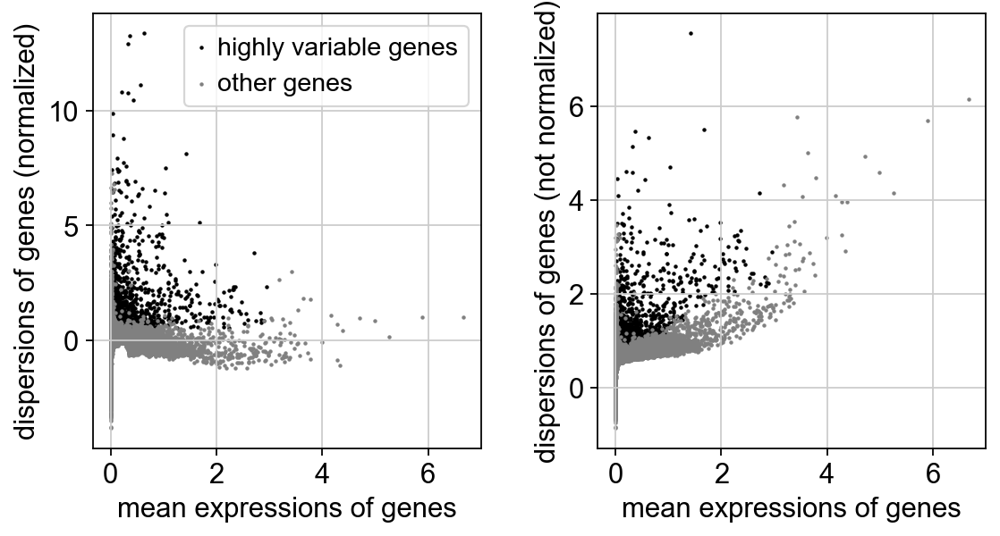

In [11]:
sc.pl.highly_variable_genes(adata)

In [12]:
#Ensure marker genes aren't making an impact to highly variable gene analysis downstream
adata.var.highly_variable['EGFP'] = False
adata.var.highly_variable['mScarlet'] = False
adata.var.highly_variable['Cre'] = False
adata.var.highly_variable['ERT'] = False
adata.var.highly_variable['iDTR'] = False
adata.var.highly_variable['tdTomato'] = False
adata.var.highly_variable['mKate2'] = False
adata.var.highly_variable['Akaluc'] = False
adata.var.highly_variable['GLuc'] = False
adata.var.highly_variable['CLuc'] = False
adata.var.highly_variable['tagBFP'] = False

/tmp/ipykernel_2564523/850513103.py:2: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  adata.var.highly_variable['EGFP'] = False
/tmp/ipykernel_2564523/850513103.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

In [13]:
adata.raw = adata

In [14]:
adata.write('write/allmice-IGO15123_IGO15342_saline.h5ad', compression='gzip')

In [15]:
sc.pp.scale(adata, max_value=10)

/home/chanj2/part2a/lib/python3.11/functools.py:909: UserWarning: zero-centering a sparse array/matrix densifies it.
  return dispatch(args[0].__class__)(*args, **kw)


## Principal component analysis

In [16]:
sc.tl.pca(adata, svd_solver='arpack', n_comps=150)

computing PCA
    with n_comps=150
    finished (0:00:05)


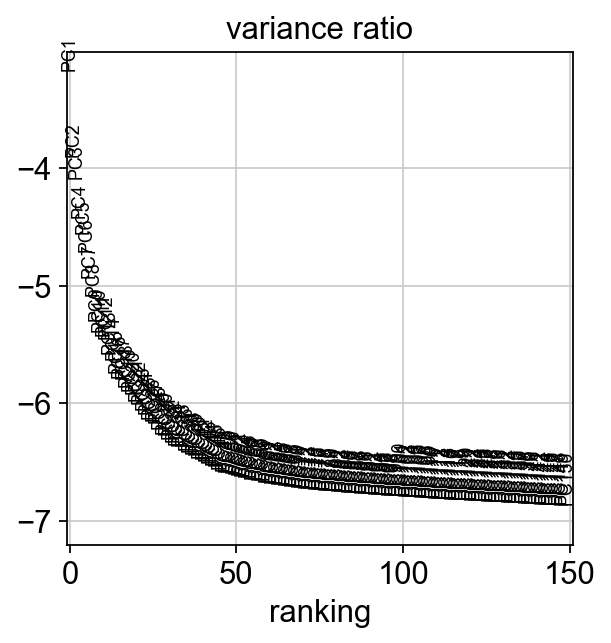

In [17]:
sc.pl.pca_variance_ratio(adata, log=True, n_pcs=150)

In [18]:
adata.write(results_file, compression='gzip')

In [19]:
adata

AnnData object with n_obs × n_vars = 10660 × 25628
    obs: 'n_counts', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'log10GenesPerUMI', 'Classification', 'Group', 'batch'
    var: 'gene_ids', 'feature_types', 'genome', 'pattern', 'read', 'sequence', 'mt', 'n_cells-First', 'n_cells_by_counts-First', 'mean_counts-First', 'pct_dropout_by_counts-First', 'total_counts-First', 'highly_variable-First', 'means-First', 'dispersions-First', 'dispersions_norm-First', 'n_cells-Second', 'n_cells_by_counts-Second', 'mean_counts-Second', 'pct_dropout_by_counts-Second', 'total_counts-Second', 'highly_variable-Second', 'means-Second', 'dispersions-Second', 'dispersions_norm-Second', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection', 'mean', 'std'
    uns: 'log1p', 'hvg', 'pca'
    obsm: 'X_pca'
    varm: 'PCs'
    layers: 'counts'

## Computing the neighborhood graph

In [20]:
sc.pp.neighbors(adata, n_neighbors=15, n_pcs=50)

computing neighbors
    using 'X_pca' with n_pcs = 50


/home/chanj2/part2a/lib/python3.11/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:19)


## Embedding the neighborhood graph

In [21]:
sc.tl.umap(adata)

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm)
    'umap', UMAP parameters (adata.uns) (0:00:13)


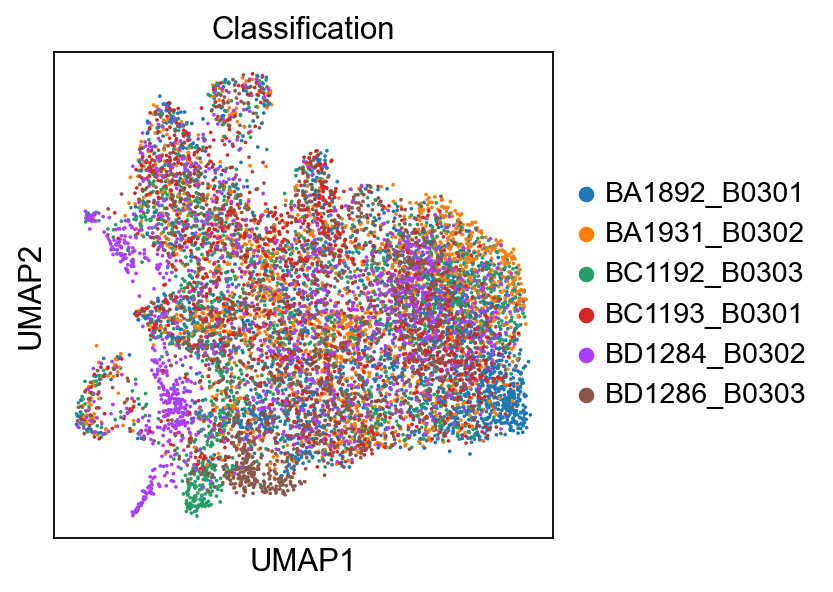

In [22]:
sc.pl.umap(adata, color=['Classification'])

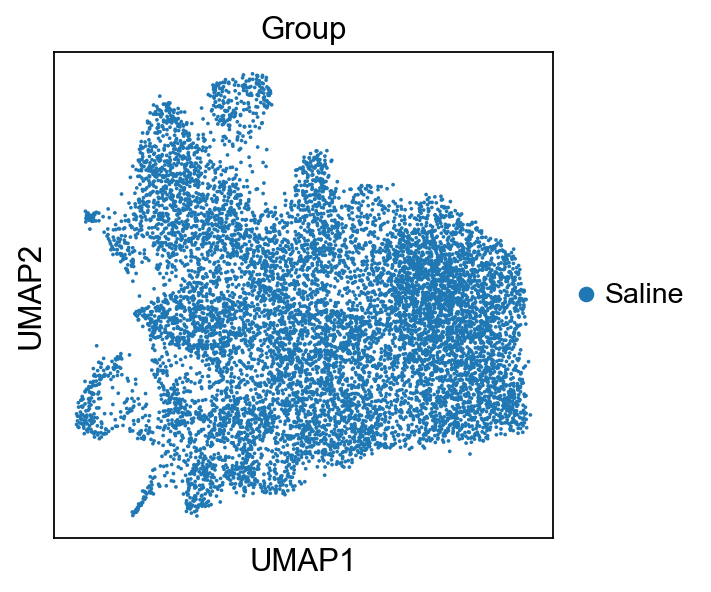

In [23]:
sc.pl.umap(adata, color=['Group'])

## Define scoring Functions

In [24]:
# Score Cluster 5 cells
import csv
clusters = {}
clusterkeys = []
HPCS = False

def resetClusters(hpcs = 'cell2020'):
    clusters = {}
    clusterkeys = []
    HPCS = False
    try:
        if hpcs == 'cell2020':         
            with open('../common_files/clusters_cell2020.csv',encoding='utf-8-sig') as csvfile:
                csvreader = csv.reader(csvfile, delimiter=",")
                for row in csvreader:
                    clusters[row[0]] = [x for x in row[1:] if x != '']
            for i in range(1,13):
                #if i == 9: continue
                clusterkeys.append('Cluster %i' % i)
            HPCS = 'Cluster 5'
        elif hpcs == 'cell2020_no_Slc4a11':         
            with open('../common_files/clusters_cell2020.csv',encoding='utf-8-sig') as csvfile:
                csvreader = csv.reader(csvfile, delimiter=",")
                for row in csvreader:
                    clusters[row[0]] = [x for x in row[1:] if x != '']   
                    if 'Slc4a11' in clusters[row[0]]:
                        clusters[row[0]].remove('Slc4a11')
                        print("Slc4a11 removed")
            for i in range(1,13):
                #if i == 9: continue
                clusterkeys.append('Cluster %i' % i)
            HPCS = 'Cluster 5'
        else:
            raise ValueError
    except ValueError:
        print("%s is an invalid choice" % hpcs)
        raise
    return (clusters, clusterkeys, HPCS)

(clusters, clusterkeys, HPCS) = resetClusters('cell2020')

In [25]:
def scoreAndPlot(ad, excludeList = None, groupby="Classification",rotation=90,numgenes=25,ctlgenes=25):
    cmap = 'jet' #colormap
    if excludeList == None:
        for i in clusterkeys:
            if (numgenes > ctlgenes):
                ctlgenes = numgenes
            sc.tl.score_genes(ad, clusters[i][0:numgenes],score_name="%s" % i, ctrl_size=ctlgenes)
  
        sc.pl.umap(ad, color=clusterkeys, color_map=cmap)
        sc.pl.dotplot(ad, clusterkeys, groupby=groupby, swap_axes=True)

In [26]:
from scipy.stats import ranksums

def HPCSViolinPlot(ad, cluster='0', groupby='leiden', score='Cluster5', save=None, singleGene=False):
    ad.obs['Cl5'] = 'not HPCS'
    ad.obs.loc[ad.obs[groupby].isin([cluster]), 'Cl5'] = 'HPCS'

    if singleGene:
        pvalue = ranksums(ad[ad.obs['Cl5'].isin(['HPCS'])][:,score].X.toarray(),ad[~ad.obs['Cl5'].isin(['HPCS'])][:,score].X.toarray())[1]
    else:
        pvalue = ranksums(ad[ad.obs['Cl5'].isin(['HPCS'])].obs[score],ad[ad.obs['Cl5'].isin(['not HPCS'])].obs[score])[1]
    sc.pl.violin(ad, score, groupby='Cl5', xlabel = 'p = ' + str(pvalue), save=save)

computing score 'Cluster 1'
    finished: added
    'Cluster 1', score of gene set (adata.obs).
    1485 total control genes are used. (0:00:00)
computing score 'Cluster 2'
    finished: added
    'Cluster 2', score of gene set (adata.obs).
    1193 total control genes are used. (0:00:00)
computing score 'Cluster 3'
    finished: added
    'Cluster 3', score of gene set (adata.obs).
    1391 total control genes are used. (0:00:00)
computing score 'Cluster 4'
    finished: added
    'Cluster 4', score of gene set (adata.obs).
    1295 total control genes are used. (0:00:00)
computing score 'Cluster 5'
    finished: added
    'Cluster 5', score of gene set (adata.obs).
    1690 total control genes are used. (0:00:00)
computing score 'Cluster 6'
       'Gm6139', 'Ldha-ps2'],
      dtype='object')
    finished: added
    'Cluster 6', score of gene set (adata.obs).
    1890 total control genes are used. (0:00:00)
computing score 'Cluster 7'
    finished: added
    'Cluster 7', score of gene

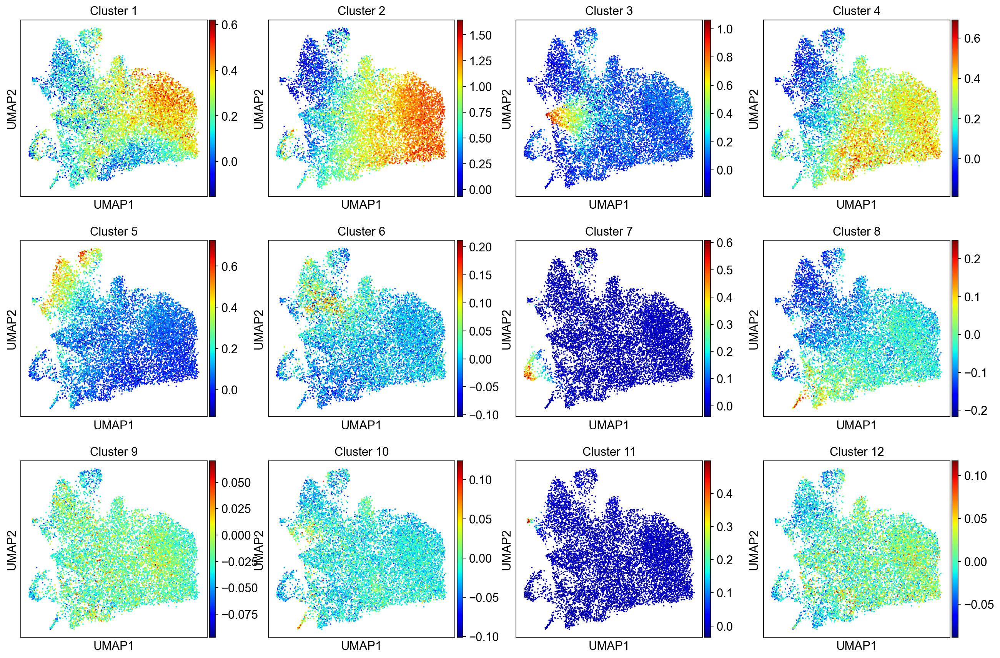

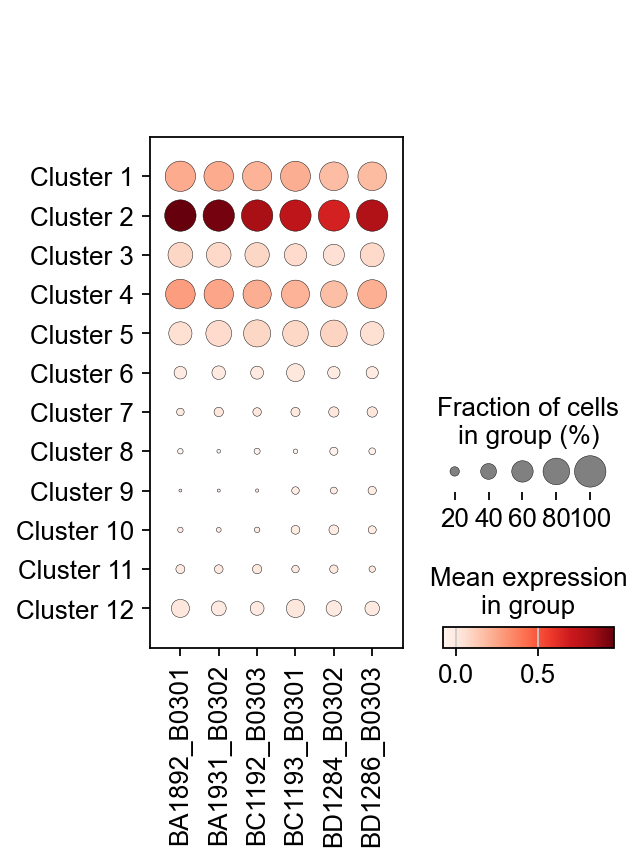

In [27]:
scoreAndPlot(adata, numgenes=100)

## Clustering the neighborhood graph

In [28]:
sc.tl.leiden(adata, resolution=.15)
#sc.tl.leiden(adata, resolution=0.25)

running Leiden clustering


/tmp/ipykernel_2564523/4057141111.py:1: FutureWarning: In the future, the default backend for leiden will be igraph instead of leidenalg.

 To achieve the future defaults please pass: flavor="igraph" and n_iterations=2.  directed must also be False to work with igraph's implementation.
  sc.tl.leiden(adata, resolution=.15)


    finished: found 4 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:00)


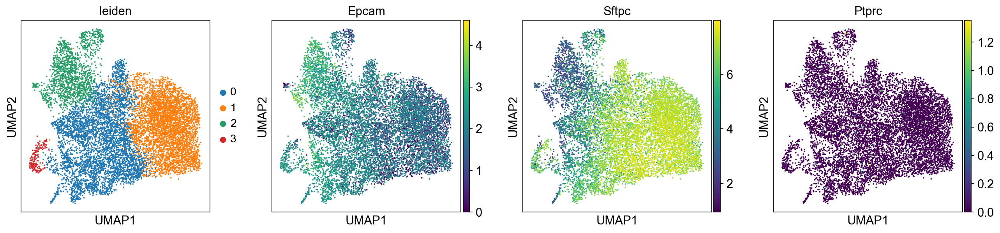

(None,)

In [29]:
sc.pl.umap(adata, color=['leiden', 'Epcam', 'Sftpc', # Tumor cells
                         'Ptprc']), #immune
                         #  'Cd4', 'Cd8a', #T cell #'Cd3e',
                         # 'Cd19', 'Ms4a1', 'Cd22', # B cell
                         # #'Itgax', 'Il3ra', # Dendritic Cell
                         # 'Ncam1',# 'Ncr1', # NK Cell
                         # 'Cd34', # Hematopoetic stem cell
                         # #'Cd14', 'Cd33', # macrophage
                         # #'Ceacam8' # Granulocyte
                         # 'Itga2b', 'Itgb3', 'Selp', #platelet
                         # #'Gypa',  # erythrocyte
                         # #'Mcam', 'Vcam1', 'Pecam1', 'Sele', # endothelial cell
                         # 'Cd109', 'Wnt5a', 'Kras'])

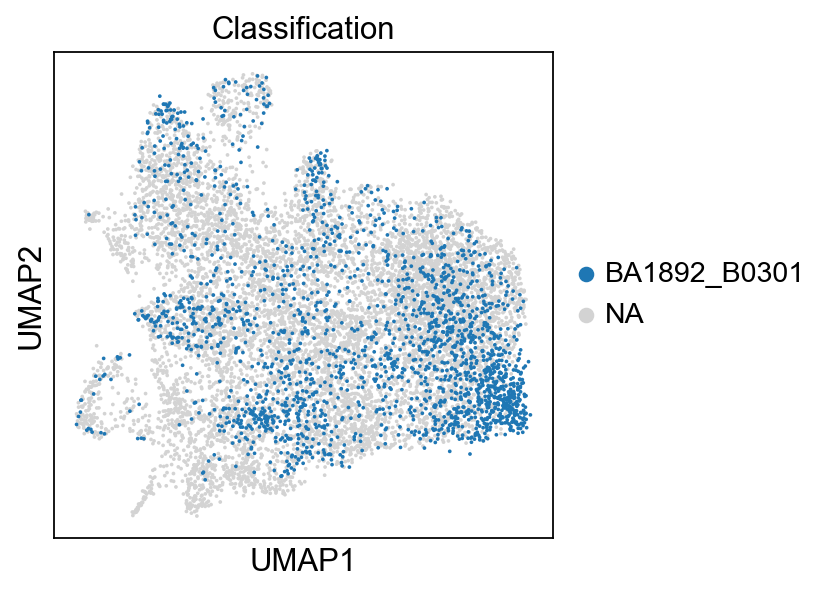

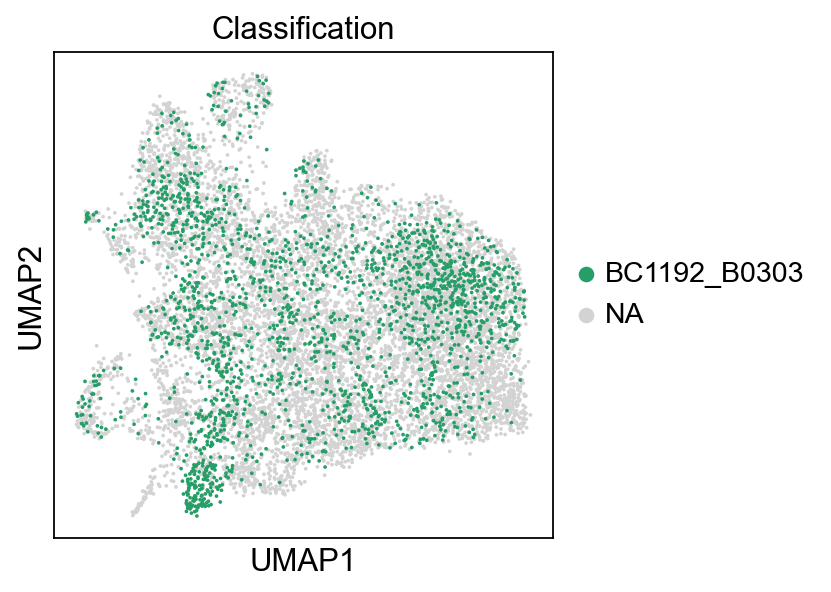

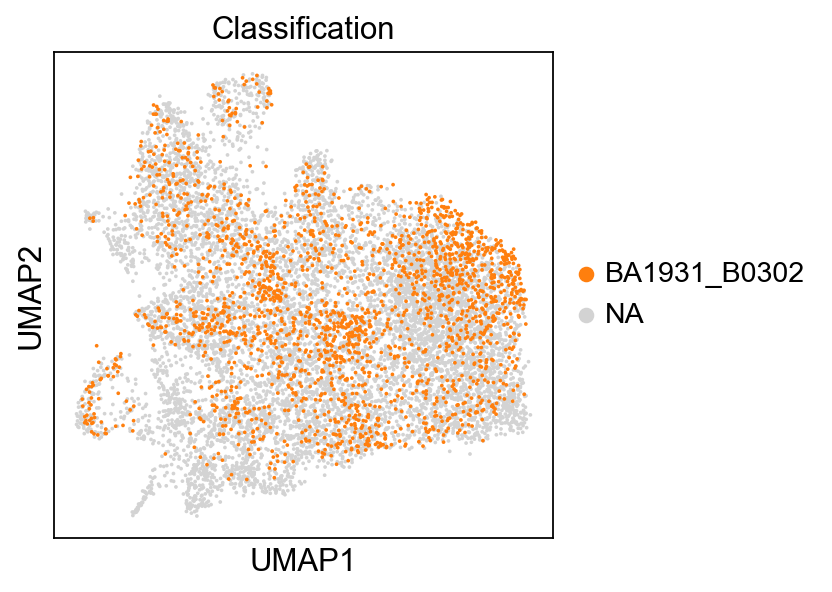

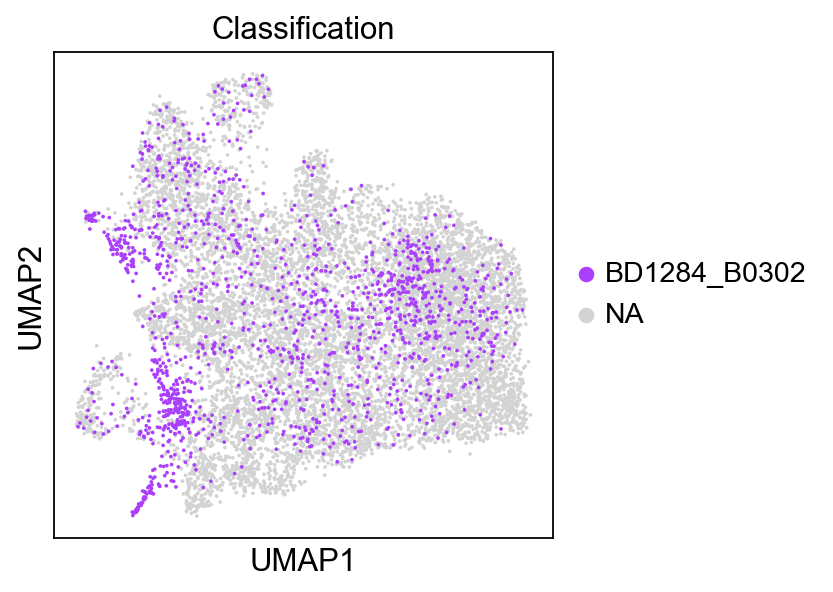

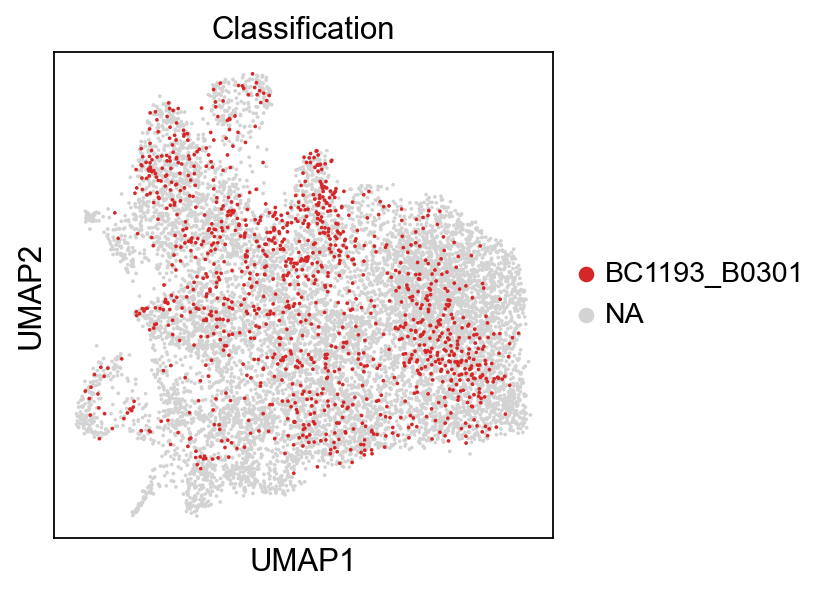

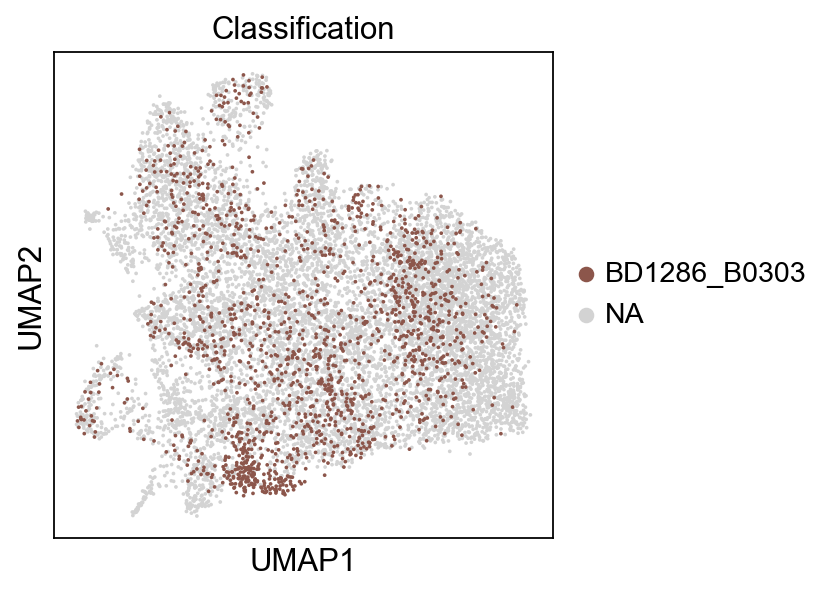

In [30]:
for label in adata.obs['Classification'].unique():
    sc.pl.umap(adata, color='Classification',groups=[label])

## Check Marker Genes

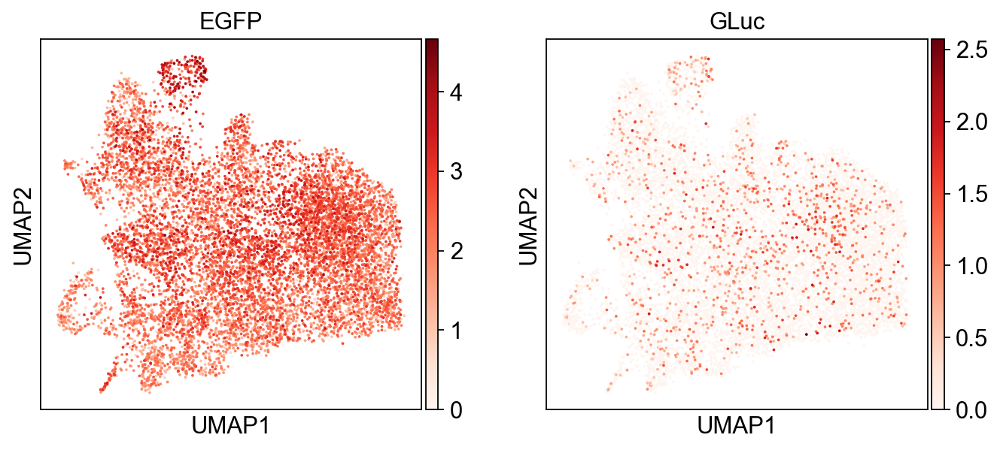

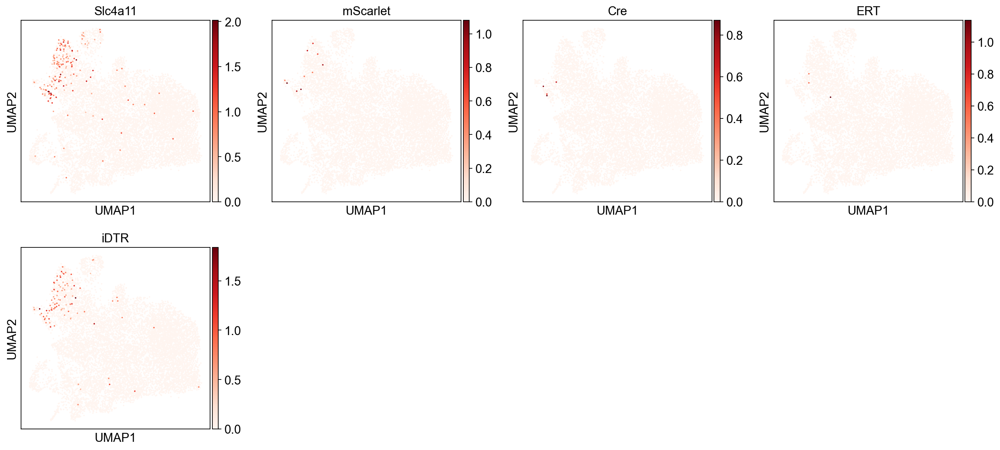

In [31]:
sc.pl.umap(adata, color=['EGFP','GLuc'], cmap='Reds')
# sc.pl.umap(adata, color=['tagBFP','CLuc'], cmap='Reds') #tagBFP and CLuc transcripts are readthrough
sc.pl.umap(adata, color=['Slc4a11','mScarlet','Cre','ERT','iDTR'], cmap='Reds')

## Compare Batches

In [32]:
adata.obs[['Group','batch','Classification']].value_counts(sort=False)

Group   batch   Classification
Saline  First   BA1892_B0301      2131
                BA1931_B0302      2158
                BC1192_B0303      2102
        Second  BC1193_B0301      1185
                BD1284_B0302      1444
                BD1286_B0303      1640
Name: count, dtype: int64

In [33]:
sc.tl.embedding_density(adata, basis='umap', groupby='batch')

computing density on 'umap'
--> added
    'umap_density_batch', densities (adata.obs)
    'umap_density_batch_params', parameter (adata.uns)


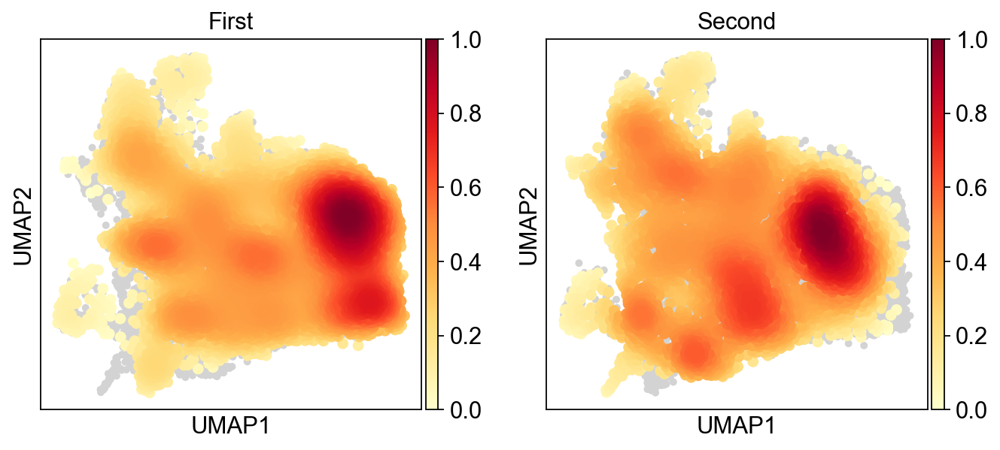

In [34]:
sc.pl.embedding_density(adata, basis='umap', key='umap_density_batch')

## Logistic Regression

In [35]:
from sklearn.linear_model import LogisticRegression
from joblib import dump, load
names = load('../common_files/genes.joblib')

In [36]:
adata_log = adata[:,adata.var.index.isin(names)]

In [37]:
adata_names = [x for x in adata_log.var.index]

In [38]:
goi = [x for x in adata_log.var.index]

## Load SmartSeq h5ad file

In [39]:
smartseq = anndata.read_h5ad('../Marjanovic_et_al_2020/write/Marjanovic_et_al_LUAD_data.h5ad')

## Logistic Regression against Cancer Cell 2020 Clusters intersected with 10x data

In [40]:
from sklearn.model_selection import train_test_split

names_adata = smartseq[:,smartseq.var.index.isin(goi)]

X_train, X_test, y_train, y_test = train_test_split(names_adata.X, smartseq.obs['clusterK12'], test_size=0.25, random_state=250)

In [41]:
names = [x for x in names_adata.var.index]

In [42]:
# import the class
from sklearn.linear_model import LogisticRegression

# instantiate the model (using the default parameters)
#logreg = LogisticRegression(random_state=250,multi_class='multinomial', solver='lbfgs')
logreg = LogisticRegression(random_state=250, solver='lbfgs')

# fit the model with data
logreg.fit(X_train, y_train)

y_pred = logreg.predict(X_test)
y_score = logreg.predict_proba(X_test)


In [43]:
# import the metrics class
from sklearn import metrics

cnf_matrix = metrics.confusion_matrix(y_test, y_pred)
cnf_matrix

array([[141,   6,   2,   0,   1,   1,   1,   0,   0,   0,   0,   0],
       [  8,  69,   0,   3,   0,   0,   0,   0,   0,   0,   0,   0],
       [  0,   0,  41,   0,   3,   0,   0,   2,   0,   1,   0,   0],
       [  0,   1,   0,  68,   0,   0,   0,   7,   1,   0,   0,   0],
       [  1,   0,   3,   0, 178,   2,   0,   4,   0,   0,   0,   1],
       [  0,   0,   0,   1,   0,  33,   0,   0,   0,   0,   0,   0],
       [  0,   0,   0,   0,   0,   0,  15,   0,   0,   0,   0,   0],
       [  0,   0,   1,   1,   1,   0,   0, 139,   1,   0,   0,   1],
       [  0,   0,   0,   1,   1,   0,   0,   1,  38,   1,   0,   0],
       [  0,   0,   1,   1,   1,   0,   0,   3,   0,  56,   0,   1],
       [  0,   0,   0,   0,   0,   0,   0,   0,   1,   0,  13,   0],
       [  0,   0,   0,   0,   1,   0,   0,   0,   1,   0,   0,  41]])

Text(0.5, 295.64444444444445, 'Predicted label')

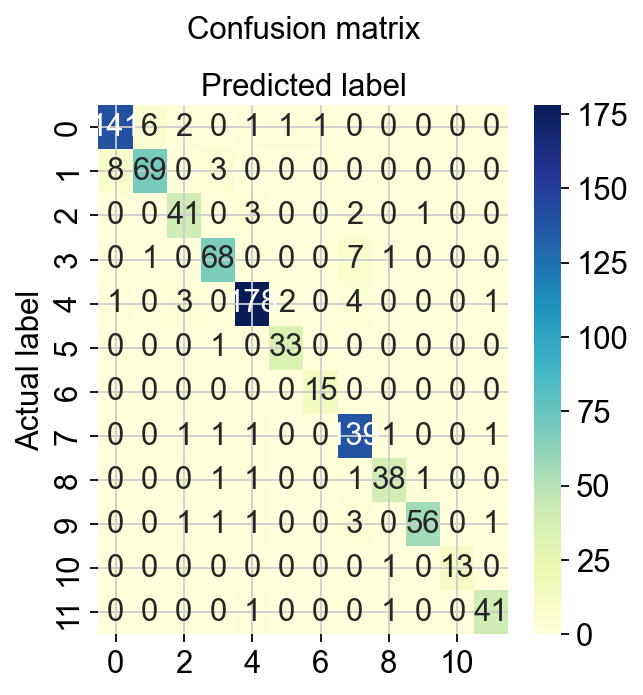

In [44]:
# import required modules
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

class_names=[0,1] # name  of classes
fig, ax = plt.subplots()
tick_marks = np.arange(len(class_names))
plt.xticks(tick_marks, class_names)
plt.yticks(tick_marks, class_names)
# create heatmap
sns.heatmap(pd.DataFrame(cnf_matrix), annot=True, cmap="YlGnBu" ,fmt='g')
ax.xaxis.set_label_position("top")
plt.tight_layout()
plt.title('Confusion matrix', y=1.1)
plt.ylabel('Actual label')
plt.xlabel('Predicted label')

#Text(0.5,257.44,'Predicted label');

In [45]:
from sklearn.metrics import classification_report
target_names = ['1', '2', '3','4','5','6','7','8','9','10','11','12']
print(classification_report(y_test, y_pred, target_names=target_names))

              precision    recall  f1-score   support

           1       0.94      0.93      0.93       152
           2       0.91      0.86      0.88        80
           3       0.85      0.87      0.86        47
           4       0.91      0.88      0.89        77
           5       0.96      0.94      0.95       189
           6       0.92      0.97      0.94        34
           7       0.94      1.00      0.97        15
           8       0.89      0.97      0.93       144
           9       0.90      0.90      0.90        42
          10       0.97      0.89      0.93        63
          11       1.00      0.93      0.96        14
          12       0.93      0.95      0.94        43

    accuracy                           0.92       900
   macro avg       0.93      0.92      0.92       900
weighted avg       0.93      0.92      0.92       900



In [46]:
from sklearn.preprocessing import LabelBinarizer

label_binarizer = LabelBinarizer().fit(y_train)
y_onehot_test = label_binarizer.transform(y_test)
y_onehot_test.shape  # (n_samples, n_classes)

(900, 12)

In [47]:
class_of_interest = '09'
class_id = np.flatnonzero(label_binarizer.classes_ == class_of_interest)[0]
class_id

np.int64(8)

/home/chanj2/part2a/lib/python3.11/site-packages/sklearn/utils/_plotting.py:176: FutureWarning: `**kwargs` is deprecated and will be removed in 1.9. Pass all matplotlib arguments to `curve_kwargs` as a dictionary instead.
  warnings.warn(


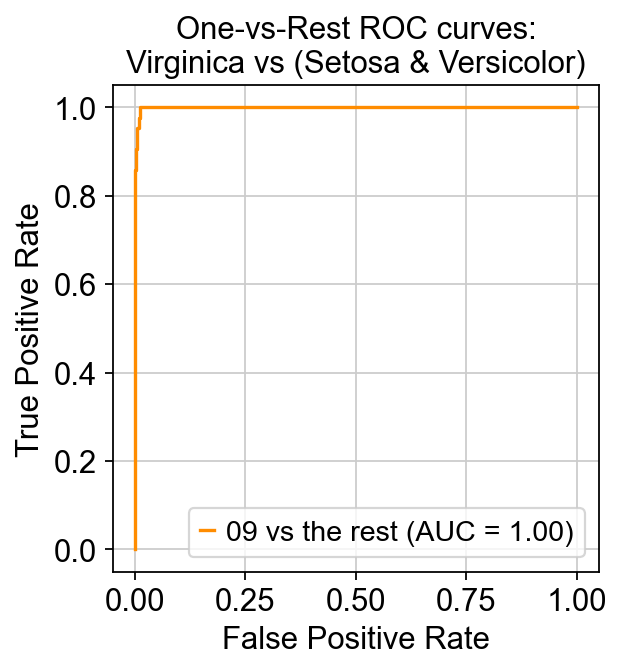

In [48]:
import matplotlib.pyplot as plt

from sklearn.metrics import RocCurveDisplay

RocCurveDisplay.from_predictions(
    y_onehot_test[:, class_id],
    y_score[:, class_id],
    name=f"{class_of_interest} vs the rest",
    color="darkorange",
    #plot_chance_level=True,
)
plt.axis("square")
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.title("One-vs-Rest ROC curves:\nVirginica vs (Setosa & Versicolor)")
plt.legend()
plt.show()

In [49]:
y_pred = logreg.predict(smartseq[:,names].X)
y_proba = logreg.predict_proba(smartseq[:,names].X)

In [50]:
smartseq.obs['clusterK12_intersecting'] = [x for x in y_pred]
smartseq.obs['clusterK12_intersecting'] = smartseq.obs['clusterK12_intersecting'].astype('category')

In [51]:
results_binary = logreg.predict(X_test)
probs_binary = logreg.predict_proba(X_test)

results_df_binary = pd.DataFrame()
results_df_binary['predicted'] = list(results_binary)
#results_df_binary['actual'] = list(smartseq.obs['clusterK12'])
results_df_binary['actual'] = list(y_test)
for x in range(0,12):
    results_df_binary["probability_%d" % (x+1)] = [i[x] for i in list(probs_binary)]
results_df_binary['highest_prob'] =results_df_binary[["probability_%d" % (x+1) for x in range(0,12)]].max(axis=1)
results_df_binary['correct'] = (results_df_binary['predicted'] == results_df_binary['actual']).astype(int)
results_df_binary

,predicted,actual,probability_1,probability_2,probability_3,probability_4,probability_5,probability_6,probability_7,probability_8,probability_9,probability_10,probability_11,probability_12,highest_prob,correct
0,08,03,1.680486e-08,1.059010e-04,1.229324e-01,2.000881e-02,1.442636e-06,4.412511e-05,4.127328e-04,8.558632e-01,2.921574e-06,2.415150e-05,2.286978e-05,5.813749e-04,0.855863,0
1,01,01,9.999899e-01,2.404320e-07,1.228560e-08,9.487811e-08,1.119154e-07,1.110077e-06,8.362132e-06,2.899248e-10,2.445402e-09,6.658944e-09,1.143081e-07,7.340528e-09,0.999990,1
2,08,08,3.472469e-09,2.361574e-07,3.173359e-07,1.643650e-06,5.818181e-06,7.806155e-07,3.086910e-05,9.999041e-01,7.914017e-06,4.259347e-05,5.269926e-06,4.108100e-07,0.999904,1
3,10,10,3.970412e-08,7.199893e-06,2.533147e-05,3.168129e-07,4.911810e-01,6.510686e-04,6.923734e-05,4.165816e-05,3.422531e-04,5.067208e-01,7.219300e-05,8.888381e-04,0.506721,1
4,08,08,7.516989e-08,4.508721e-07,6.246960e-08,4.340547e-06,1.232151e-05,1.243345e-06,1.150538e-04,9.995965e-01,2.398985e-04,1.800539e-05,6.428957e-06,5.664612e-06,0.999596,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
895,05,05,2.796106e-04,1.532551e-07,3.081756e-06,3.825711e-05,9.894155e-01,5.058316e-03,3.350294e-04,2.318741e-03,7.091694e-04,1.657638e-03,1.723417e-04,1.211811e-05,0.989416,1
896,05,05,2.976253e-10,3.328314e-07,2.329048e-07,1.783815e-07,9.999854e-01,7.027092e-06,3.620802e-07,6.225438e-10,1.221655e-07,2.435356e-07,5.213913e-06,9.112686e-07,0.999985,1
897,08,08,2.142820e-06,5.657977e-05,7.539774e-06,1.105475e-02,4.490768e-08,4.159371e-06,8.700428e-05,9.875366e-01,1.070501e-03,1.378917e-04,1.927814e-05,2.353210e-05,0.987537,1
898,05,05,6.361106e-11,1.987644e-07,4.086939e-06,7.807464e-12,9.999943e-01,5.147045e-08,2.892622e-07,5.134765e-07,6.702151e-08,6.796511e-08,3.378301e-07,1.019797e-07,0.999994,1


In [52]:
results_df_binary['bin'] = pd.qcut(results_df_binary['highest_prob'], q=7)
idx = pd.IntervalIndex(results_df_binary['bin'])
results_df_binary['low'] = idx.left
results_df_binary['high'] = idx.right
results_df_binary['prob range'] = results_df_binary['low'].round(2).astype(str) + "-" + results_df_binary['high'].round(2).astype(str)
df_bins_grouped = results_df_binary[['low','high','correct','prob range']].groupby('prob range').mean().reset_index()
df_bins_grouped

,prob range,low,high,correct
0,0.36-0.88,0.357322,0.875119,0.643411
1,0.88-0.98,0.875119,0.981243,0.898438
2,0.98-1.0,0.981243,0.996590,0.945736
3,1.0-1.0,0.999031,0.999881,0.996109


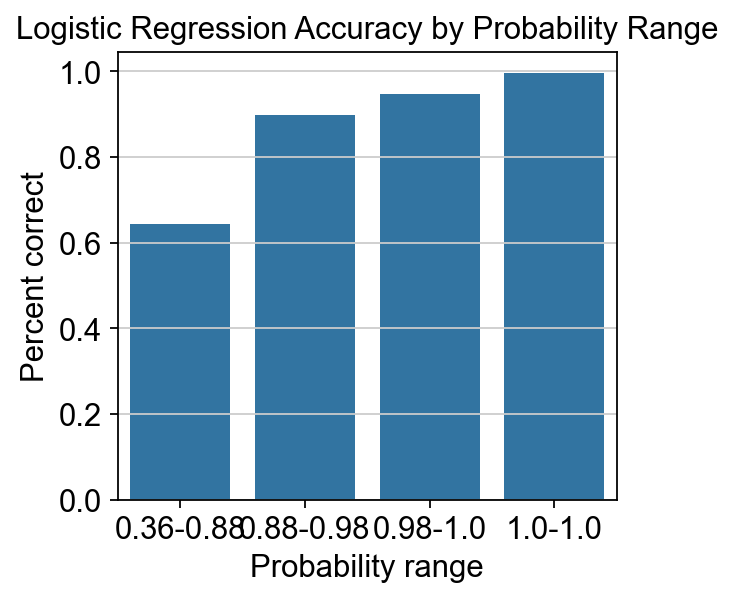

In [53]:
%matplotlib inline
import matplotlib.pyplot as plt
import seaborn as sns
plt.figure(figsize=(4,4))
plt.subplots_adjust(top=0.85)

ax = sns.barplot(x='prob range', y='correct', data=df_bins_grouped)
plt.title("Logistic Regression Accuracy by Probability Range")
plt.ylabel('Percent correct')
plt.xlabel('Probability range')
plt.show()

In [54]:
#reset size
from matplotlib import rcParams
FIGSIZE=(4,4)
rcParams['figure.figsize']=FIGSIZE

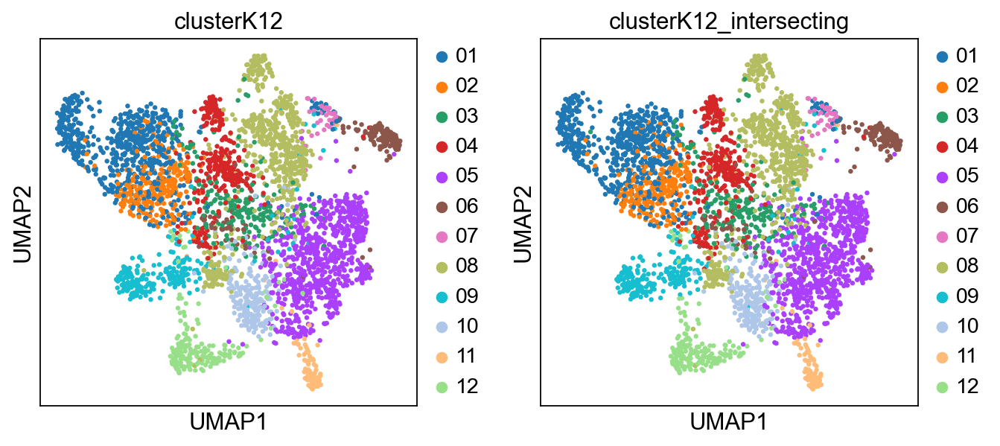

In [55]:
sc.pl.umap(smartseq, color=['clusterK12','clusterK12_intersecting'])

In [56]:
dict = {1: "01", 2: "02", 3: "03", 4: "04", 5: "05", 6: "06", 7: "07", 8: "08", 9: "09", 10: "10", 11: "11", 12: "12"}

In [57]:
from sklearn.metrics import accuracy_score
accuracy_score(smartseq.obs.replace({"clusterK12": dict})['clusterK12'], smartseq.obs['clusterK12_intersecting'])

0.9811111111111112

In [58]:
results_binary = logreg.predict(smartseq[:,names].X)
probs_binary = logreg.predict_proba(smartseq[:,names].X)

results_df_binary = pd.DataFrame()
results_df_binary['predicted'] = list(results_binary)

for x in range(0,12):
    results_df_binary[x+1] = [i[x] for i in list(probs_binary)]
results_df_binary['highest_prob'] =results_df_binary[[x+1 for x in range(0,12)]].max(axis=1)
results_df_binary

,predicted,1,2,3,4,5,6,7,8,9,10,11,12,highest_prob
0,11,1.145957e-12,1.236296e-10,9.583881e-11,2.408215e-13,8.647340e-09,2.623017e-11,3.687946e-09,9.072413e-12,1.679106e-10,9.205164e-11,1.000000e+00,1.229048e-09,1.000000
1,12,2.090869e-10,2.650150e-11,8.975100e-11,2.588890e-09,2.908884e-09,9.565509e-07,1.706366e-08,4.270725e-08,9.824308e-08,4.370815e-07,9.307861e-09,9.999984e-01,0.999998
2,05,8.936681e-04,2.108609e-07,3.504624e-04,2.068211e-07,9.987345e-01,1.541844e-05,6.862646e-07,9.355205e-11,2.756827e-07,8.896415e-07,8.533490e-07,2.814093e-06,0.998735
3,10,5.030088e-07,3.832882e-07,4.582477e-07,1.805526e-03,6.670369e-07,8.650906e-06,7.064146e-06,2.637445e-03,8.401670e-06,9.955105e-01,4.132071e-06,1.631190e-05,0.995510
4,01,9.999964e-01,5.490397e-09,1.424770e-06,1.657961e-06,9.513835e-09,9.958279e-08,7.128439e-08,2.061632e-10,1.753019e-10,7.138992e-09,3.205788e-07,1.699390e-08,0.999996
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3595,08,3.287181e-10,8.812750e-08,6.513716e-09,1.362302e-07,1.388041e-08,6.967690e-09,5.356642e-07,9.999961e-01,2.933539e-06,1.367757e-07,5.793607e-08,8.675464e-09,0.999996
3596,09,9.120150e-08,2.618794e-07,1.266113e-07,9.504733e-08,1.233419e-06,4.603948e-08,1.354694e-06,3.348794e-04,9.996582e-01,2.569569e-07,3.348464e-06,1.170258e-07,0.999658
3597,08,3.385873e-08,3.664047e-06,7.761144e-08,4.245968e-05,2.286035e-08,5.206718e-08,6.876615e-06,9.998499e-01,9.149674e-05,2.536329e-06,2.091122e-06,8.329355e-07,0.999850
3598,08,7.718238e-09,2.210094e-06,2.804774e-06,1.844546e-06,4.189273e-04,2.016069e-07,1.060660e-05,9.995333e-01,9.392417e-06,1.459888e-05,4.154656e-06,1.921651e-06,0.999533


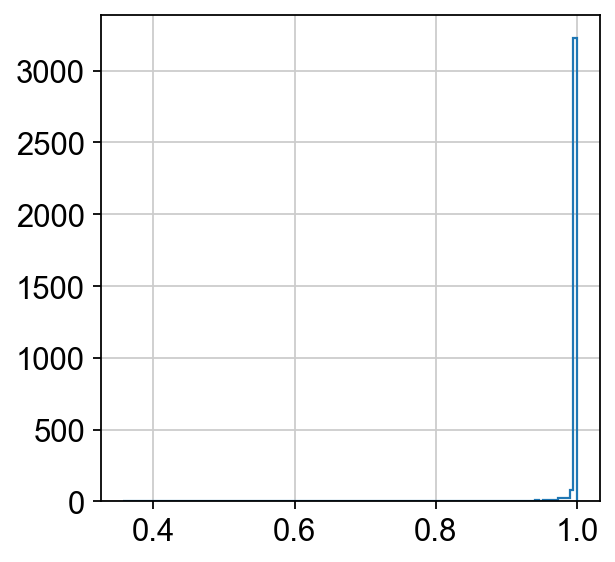

In [59]:
_ = plt.hist(results_df_binary['highest_prob'], bins='auto', histtype='step')

## Evaluate LogisticRegression

In [60]:
adata_ordered_genes = [adata_names.index(x) for x in names]

In [61]:
adata_log_ordered = adata_log[:,adata_ordered_genes]

In [62]:
y_pred = logreg.predict(adata_log_ordered.X)

In [63]:
adata_log_ordered.obs['clusterK12'] = [x for x in y_pred]
adata_log_ordered.obs['clusterK12'] = adata_log_ordered.obs['clusterK12'].astype('category')

/tmp/ipykernel_2564523/3908199522.py:1: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata_log_ordered.obs['clusterK12'] = [x for x in y_pred]


In [64]:
#reset size
from matplotlib import rcParams
FIGSIZE=(4,4)
rcParams['figure.figsize']=FIGSIZE

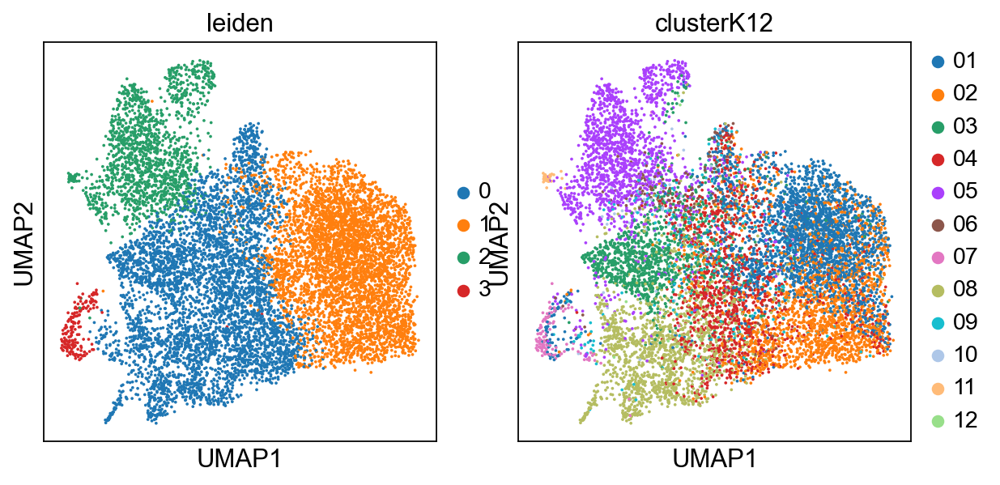

In [65]:
sc.pl.umap(adata_log_ordered,color=['leiden','clusterK12'], wspace=0.1)

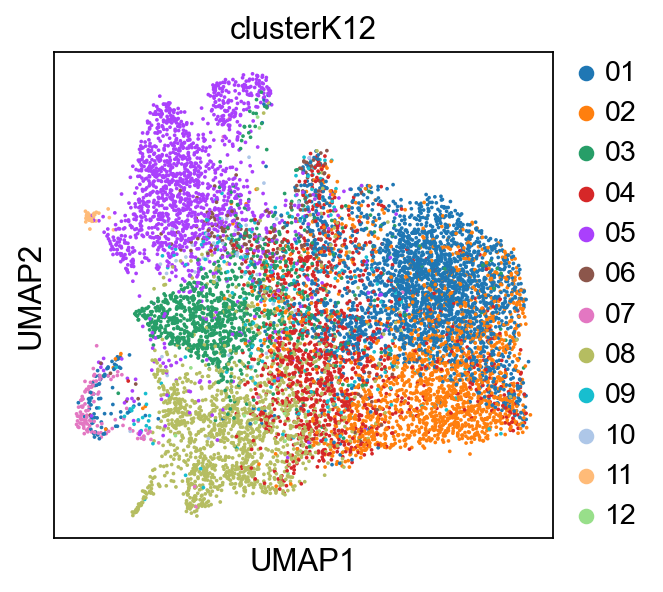

In [66]:
sc.pl.umap(adata_log_ordered,color=['clusterK12'])

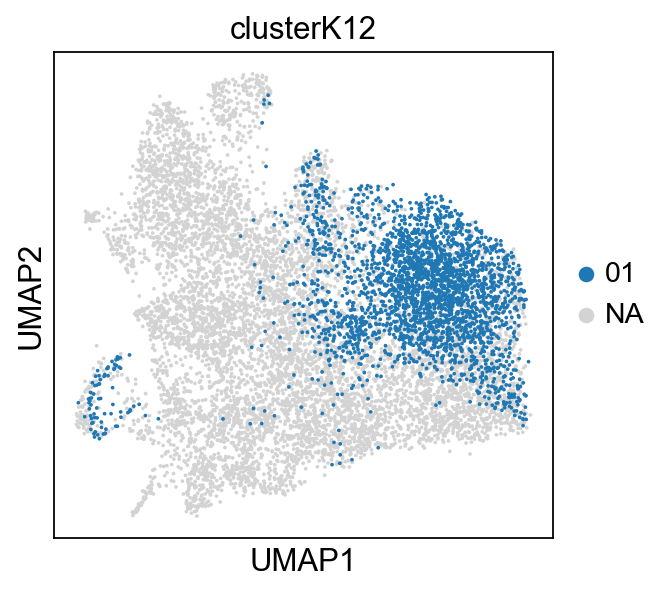

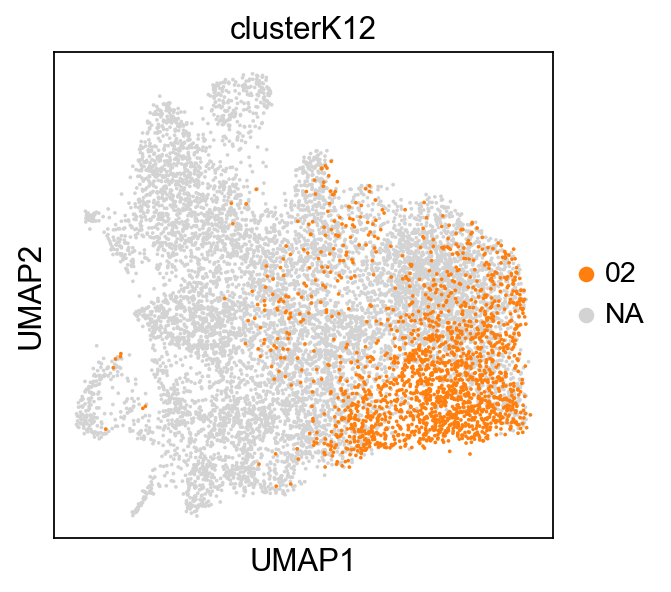

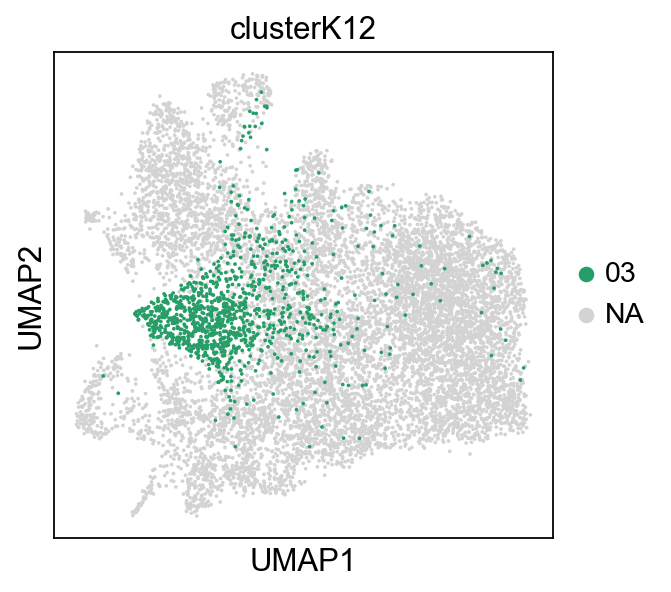

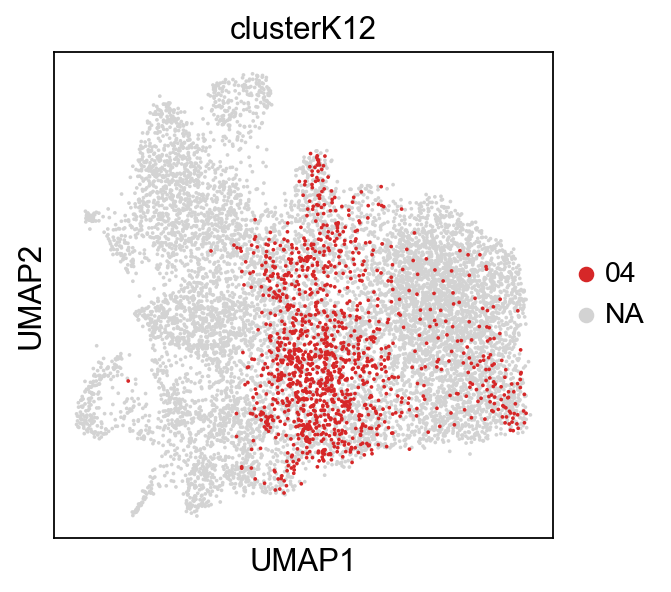

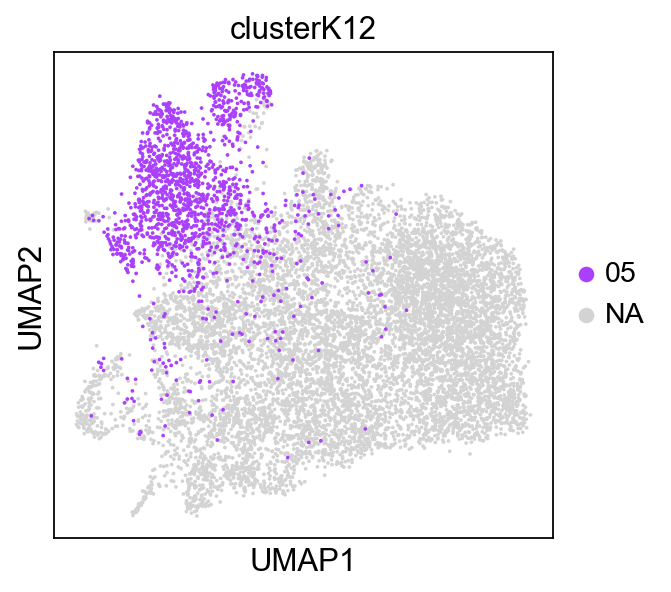

...

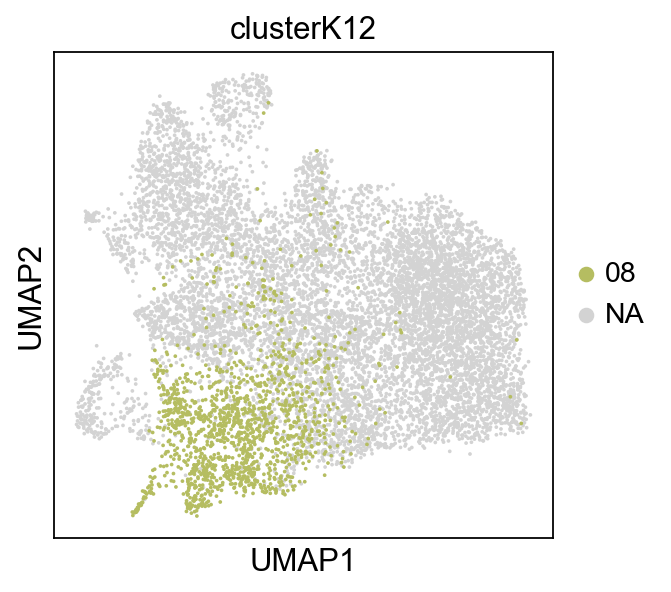

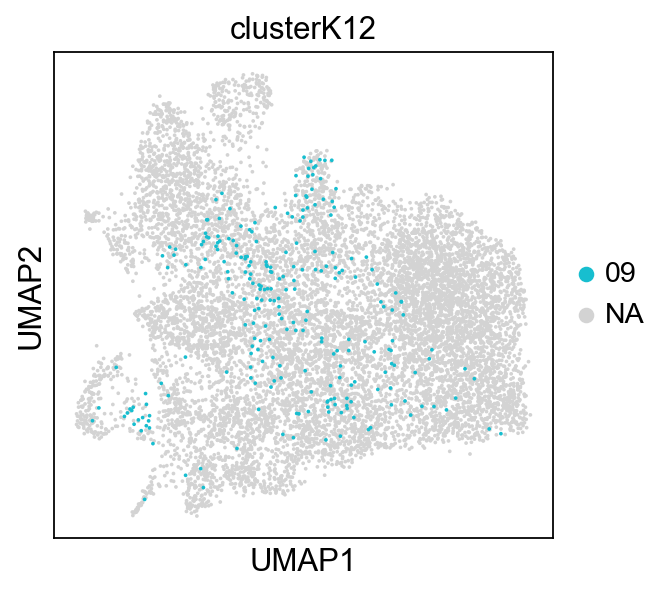

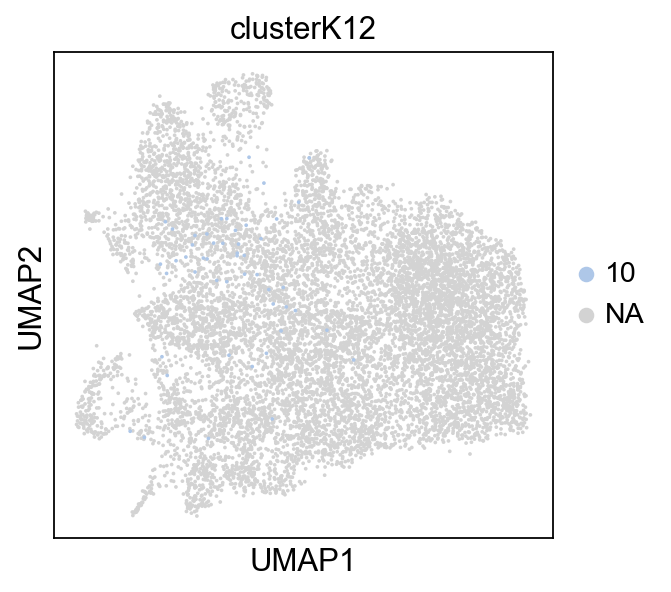

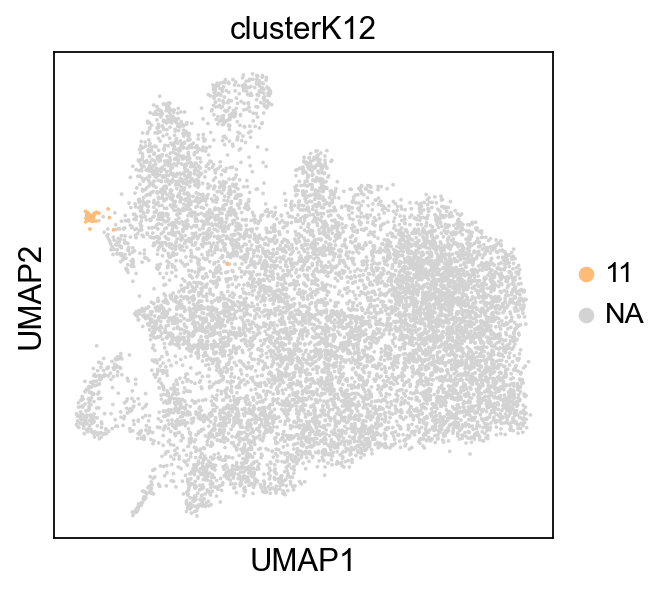

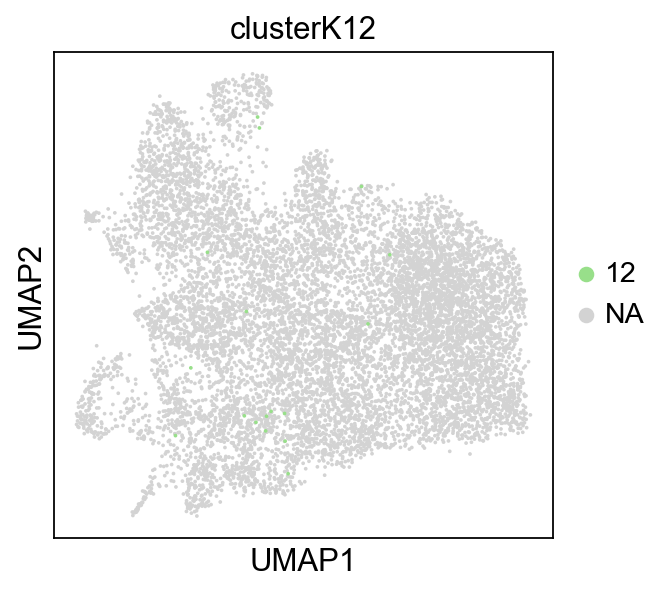

In [67]:
for x in adata_log_ordered.obs.clusterK12.cat.categories:
    sc.pl.umap(adata_log_ordered,color=['clusterK12'], groups=[x])

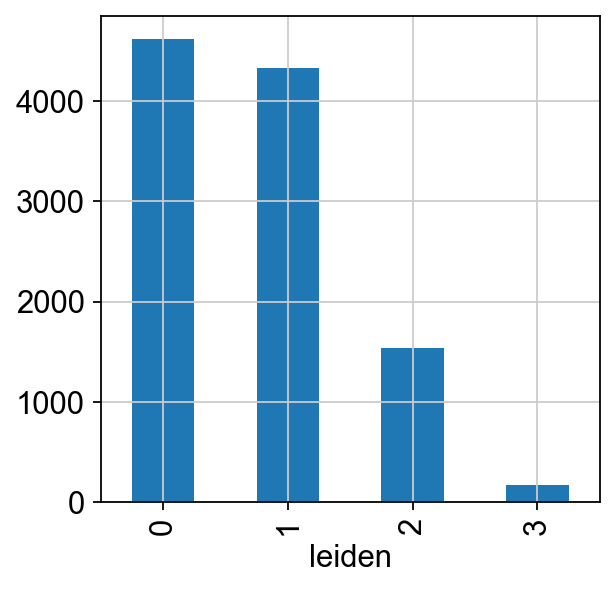

In [68]:
 cell_proportion_df = adata_log_ordered.obs.leiden.value_counts().T.plot(kind='bar', stacked=True, legend=False)

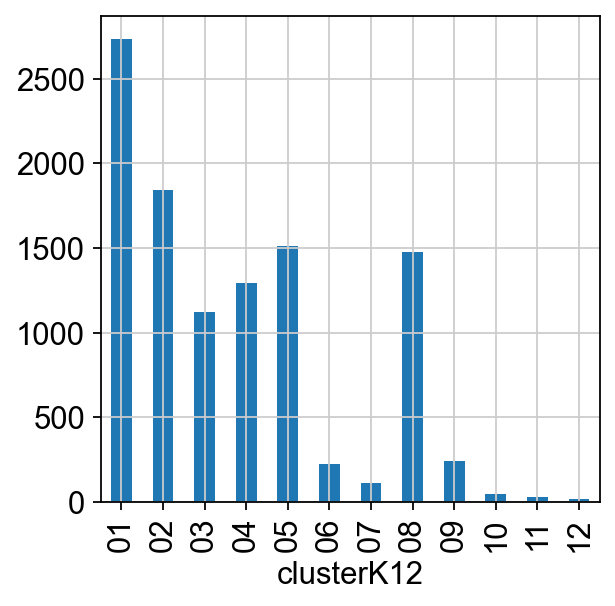

In [69]:
 cell_proportion_df = adata_log_ordered.obs.clusterK12.value_counts(sort=False).T.plot(kind='bar', stacked=True, legend=False)

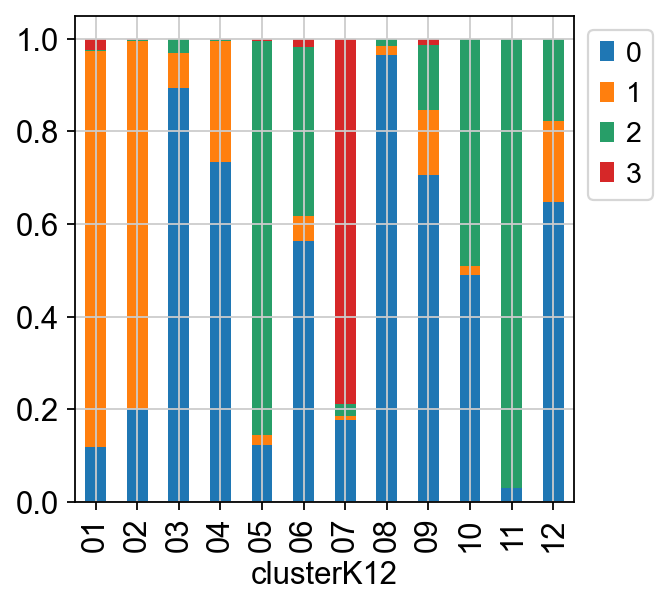

In [70]:
 cell_proportion_df = pd.crosstab(adata_log_ordered.obs['leiden'],adata_log_ordered.obs['clusterK12'], normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

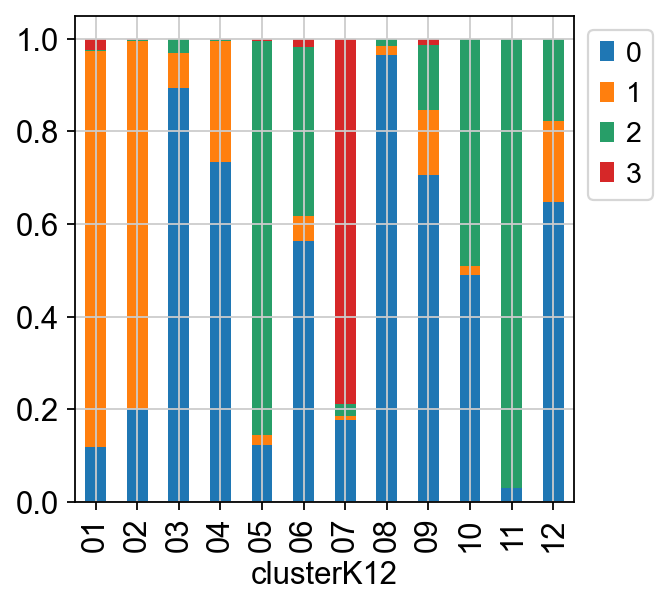

In [71]:
 cell_proportion_df = pd.crosstab(adata_log_ordered.obs['leiden'],adata_log_ordered.obs['clusterK12'], normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

In [72]:
results_binary = logreg.predict(adata_log_ordered.X)
probs_binary = logreg.predict_proba(adata_log_ordered.X)

results_df_binary = pd.DataFrame()
results_df_binary['predicted'] = list(results_binary)
#results_df_binary['actual'] = list(smartseq.obs['clusterK12'])
for x in range(0,12):
    results_df_binary[x+1] = [i[x] for i in list(probs_binary)]
results_df_binary['highest_prob'] =results_df_binary[[x+1 for x in range(0,12)]].max(axis=1)
results_df_binary

,predicted,1,2,3,4,5,6,7,8,9,10,11,12,highest_prob
0,02,1.643592e-02,4.683611e-01,5.714293e-03,6.806136e-02,0.006183,0.028147,0.012997,2.830989e-01,4.899173e-02,0.024780,0.034575,0.002654,0.468361
1,05,3.871800e-09,1.489622e-08,5.477167e-08,2.405604e-07,0.999521,0.000441,0.000002,4.124608e-08,4.699468e-07,0.000009,0.000018,0.000009,0.999521
2,01,6.268337e-01,6.290081e-02,8.208033e-03,2.324493e-01,0.004364,0.009013,0.011655,1.697481e-03,7.764471e-03,0.014552,0.013478,0.007084,0.626834
3,08,2.653357e-06,2.002686e-08,1.395254e-06,6.097552e-05,0.000001,0.000001,0.000066,9.995876e-01,1.515653e-04,0.000021,0.000013,0.000093,0.999588
4,01,9.072509e-01,8.852420e-03,8.649196e-04,4.256861e-02,0.000166,0.006448,0.007807,5.638147e-03,5.398588e-03,0.004809,0.006668,0.003528,0.907251
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10655,02,3.028516e-02,7.980056e-01,6.305609e-02,2.992724e-02,0.000389,0.042523,0.004678,1.014451e-02,3.046813e-03,0.010793,0.005765,0.001386,0.798006
10656,05,1.560566e-02,1.267207e-03,2.385080e-02,1.092461e-05,0.450445,0.368657,0.067898,2.654532e-07,1.753236e-04,0.007158,0.037985,0.026948,0.450445
10657,02,6.661316e-02,3.165380e-01,4.105470e-02,1.268304e-01,0.000747,0.053665,0.016868,2.478960e-02,2.764683e-01,0.042416,0.014715,0.019295,0.316538
10658,08,3.109018e-04,5.757053e-03,2.505722e-03,7.028871e-03,0.000207,0.001286,0.005765,9.633491e-01,4.356754e-03,0.004886,0.002306,0.002242,0.963349


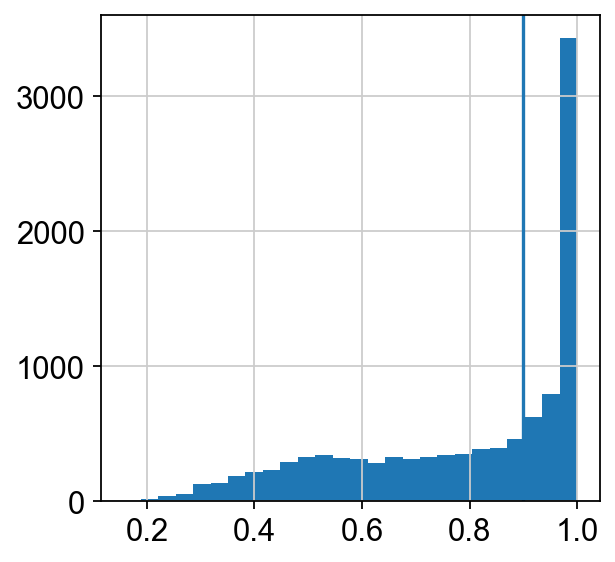

In [73]:
_ = plt.hist(results_df_binary['highest_prob'], bins='auto')
plt.axvline(x=0.9)

In [74]:
results_df_binary['bin'] = pd.qcut(results_df_binary['highest_prob'], q=7)
idx = pd.IntervalIndex(results_df_binary['bin'])
results_df_binary['low'] = idx.left
results_df_binary['high'] = idx.right
results_df_binary['prob range'] = results_df_binary['low'].round(2).astype(str) + "-" + results_df_binary['high'].round(2).astype(str)
df_bins_grouped = results_df_binary[['low','high','prob range']].groupby('prob range').mean().reset_index()
df_bins_grouped

,prob range,low,high
0,0.16-0.5,0.155,0.501
1,0.5-0.66,0.501,0.656
2,0.66-0.8,0.656,0.805
3,0.8-0.92,0.805,0.919
4,0.92-0.98,0.919,0.978
5,0.98-1.0,0.978,0.998
6,1.0-1.0,0.998,1.000


In [75]:
cutoff = 0.8
adata_log_ordered.obs['clusterK12_stringent'] = 'other'
adata_log_ordered.obs['clusterK12_stringent'][np.array(results_df_binary['highest_prob'] >= cutoff)] = ["%02d" % y for y in results_df_binary[[x+1 for x in range(0,12)]].idxmax(axis=1)[np.array(results_df_binary['highest_prob'] >= cutoff)].to_numpy()]

/tmp/ipykernel_2564523/4020989001.py:3: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  adata_log_ordered.obs['clusterK12_stringent'][np.array(results_df_binary['highest_prob'] >= cutoff)] = ["%02d" % y for y in results_df_binary[[x+1 for x in

In [76]:
adata_log_ordered.obs['clusterK12_stringent']

AAACCCAAGAACAAGG-1-First     other
AAACCCAAGCGCAATG-1-First        05
AAACCCAGTATCAAGA-1-First     other
AAACCCATCAGATTGC-1-First        08
AAACCCATCTAGAGCT-1-First        01
                             ...  
TTTGGTTGTTCCAAAC-1-Second    other
TTTGGTTTCAAAGGTA-1-Second    other
TTTGGTTTCAAGAGTA-1-Second    other
TTTGGTTTCGCAATTG-1-Second       08
TTTGTTGCATCAGCAT-1-Second    other
Name: clusterK12_stringent, Length: 10660, dtype: object

In [77]:
adata_log_ordered.obs['clusterK12_stringent'] = adata_log_ordered.obs['clusterK12_stringent'].astype('category')

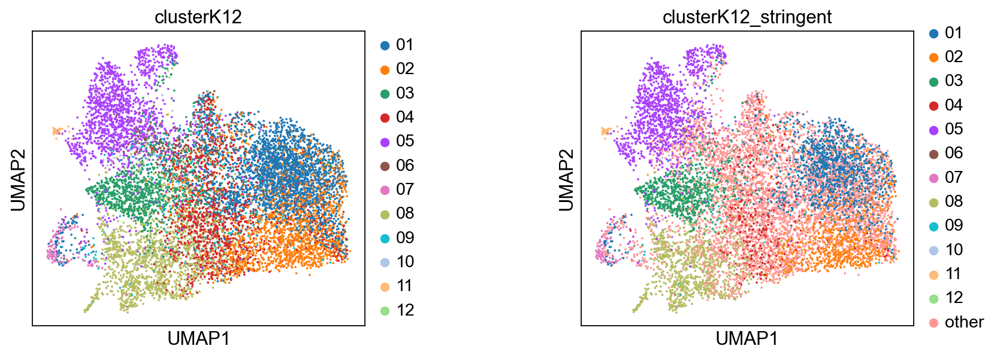

In [78]:
sc.pl.umap(adata_log_ordered, color=['clusterK12', 'clusterK12_stringent'], wspace=0.5)

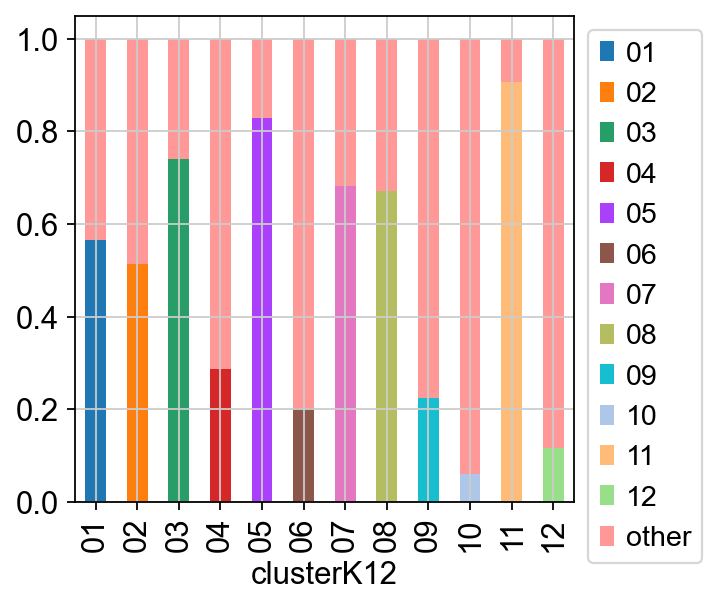

In [79]:
 cell_proportion_df = pd.crosstab(adata_log_ordered.obs['clusterK12_stringent'],adata_log_ordered.obs['clusterK12'],normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

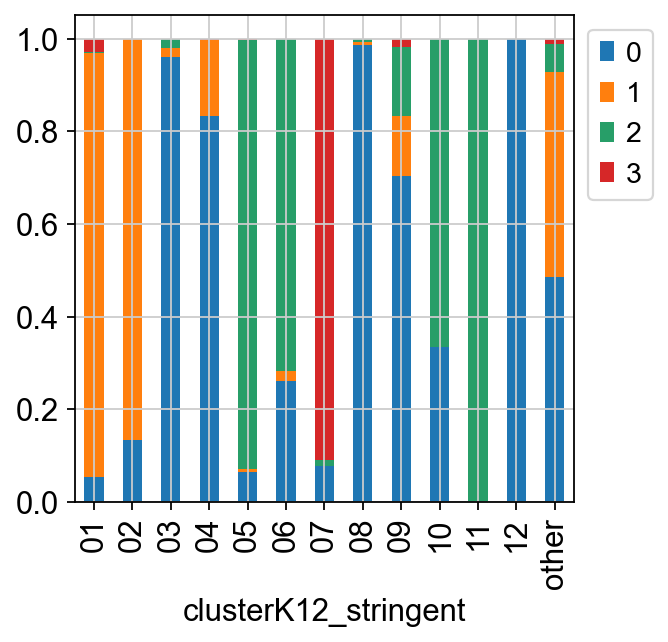

In [80]:
 cell_proportion_df = pd.crosstab(adata_log_ordered.obs['leiden'],adata_log_ordered.obs['clusterK12_stringent'], normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

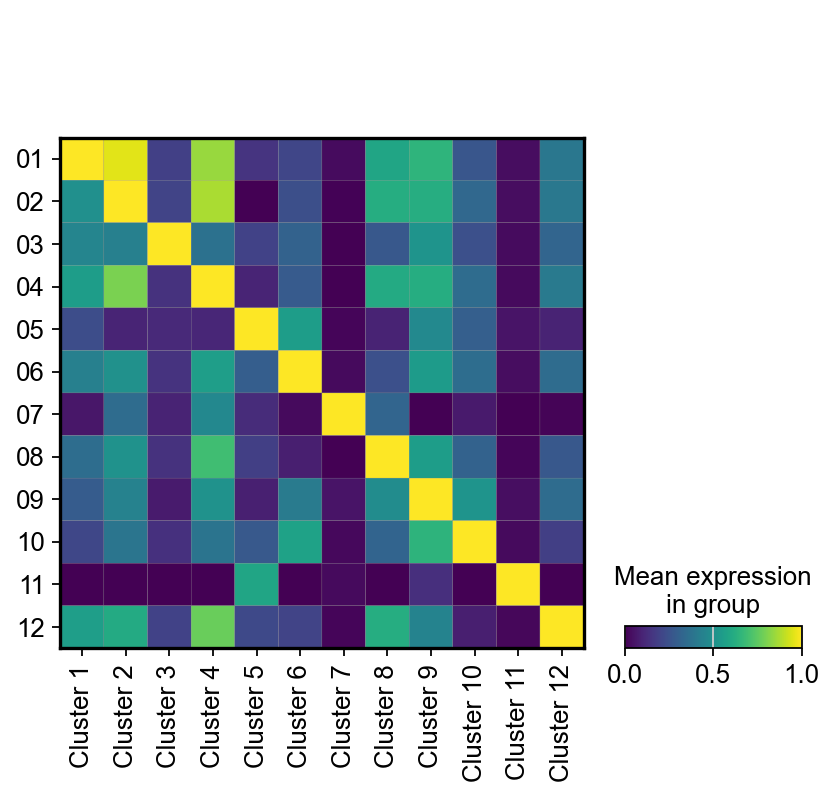

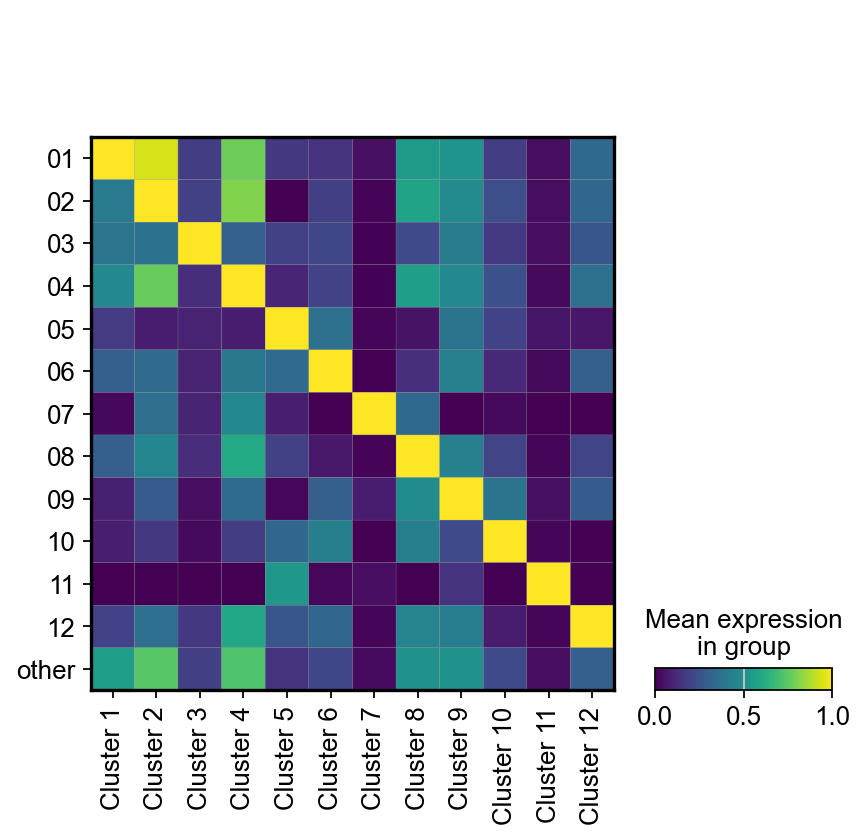

In [81]:
cancerCell = ['Cluster 1', 'Cluster 2','Cluster 3','Cluster 4','Cluster 5','Cluster 6', 'Cluster 7', 
              'Cluster 8', 'Cluster 9', 'Cluster 10', 'Cluster 11', 'Cluster 12']
#cell_proportion_df = pd.crosstab(adata_log_ordered.obs['Cluster 1'],adata_log_ordered.obs['clusterK12']).T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))
sc.pl.matrixplot(adata_log_ordered, cancerCell, 'clusterK12', standard_scale='var')
sc.pl.matrixplot(adata_log_ordered, cancerCell, 'clusterK12_stringent', standard_scale='var')

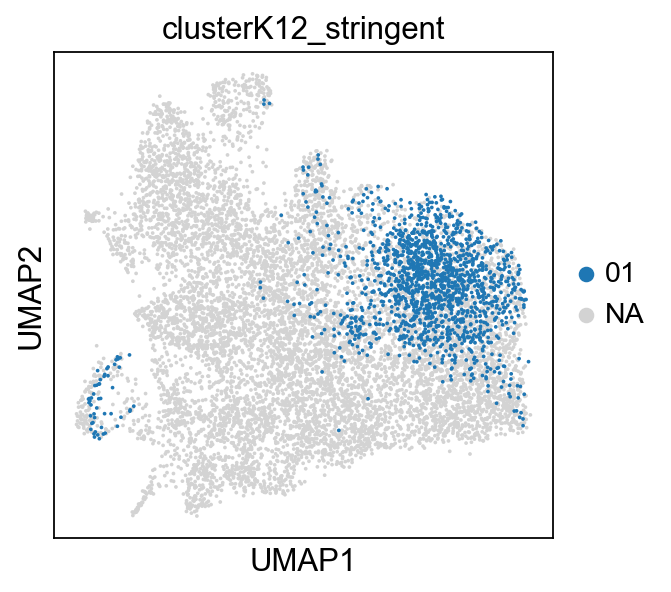

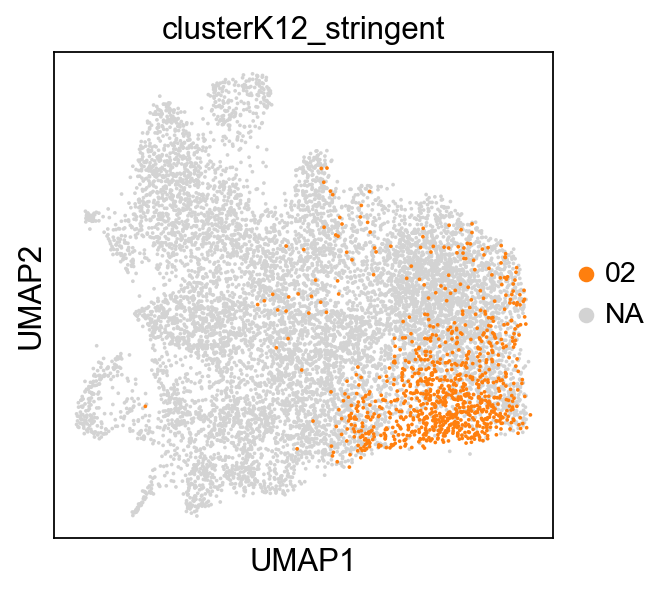

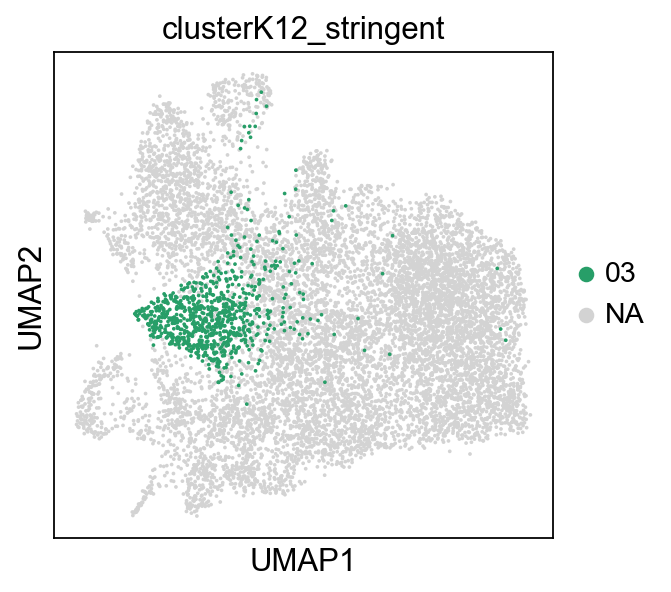

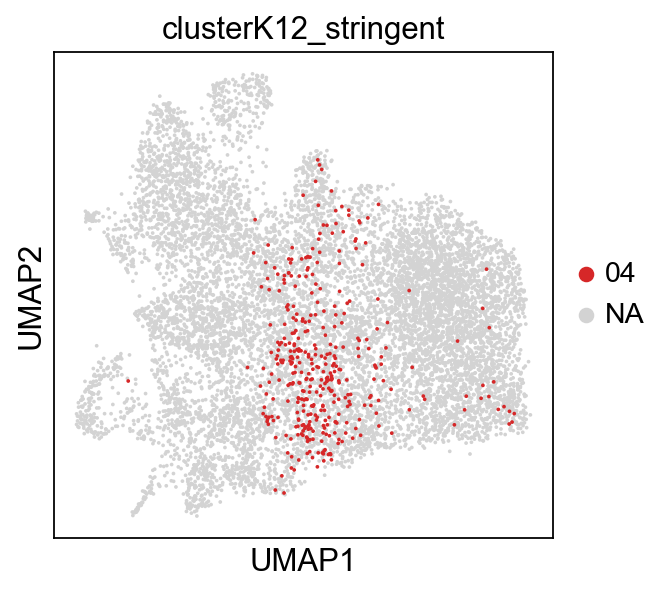

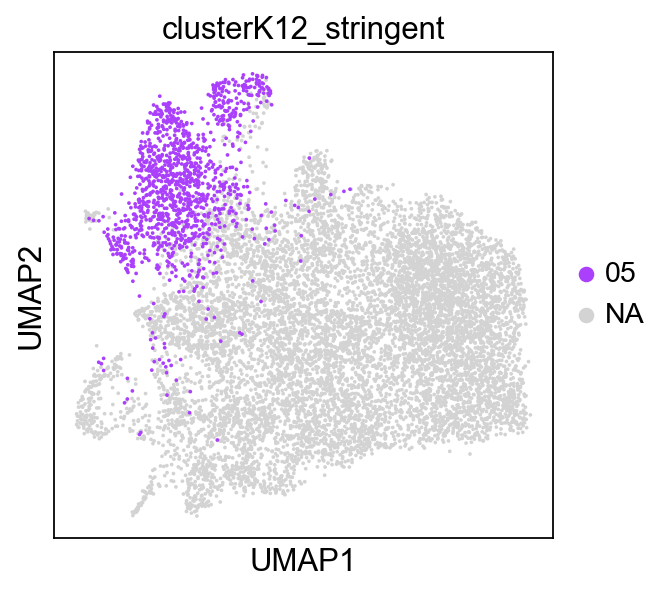

...

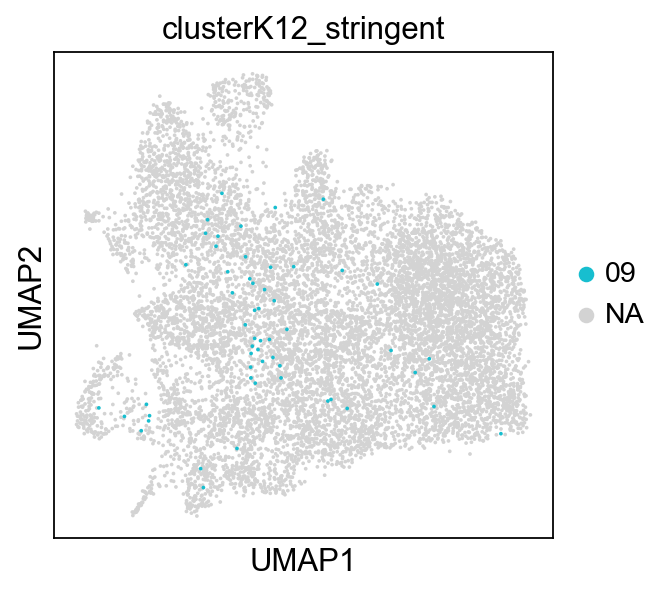

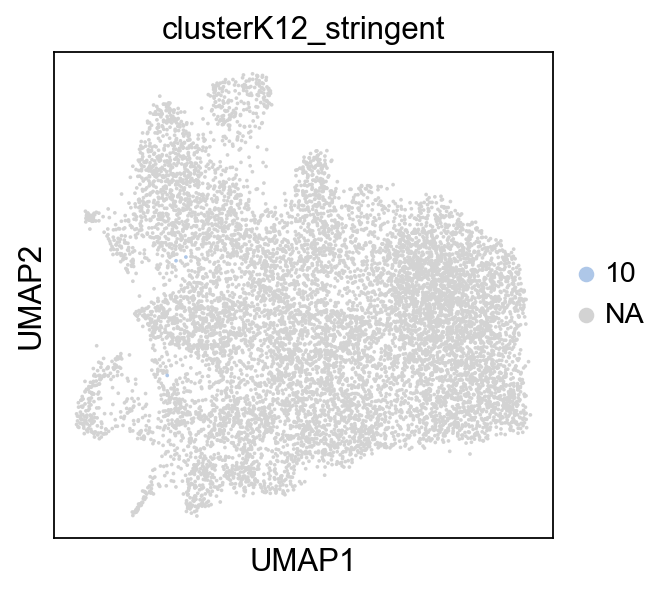

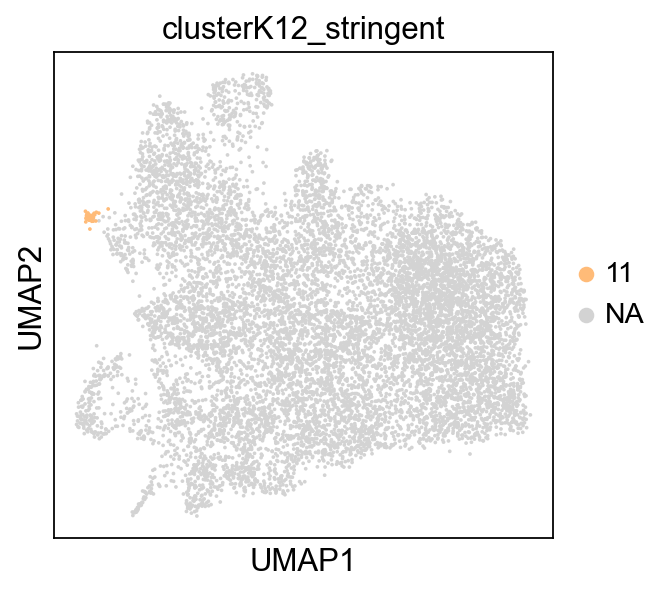

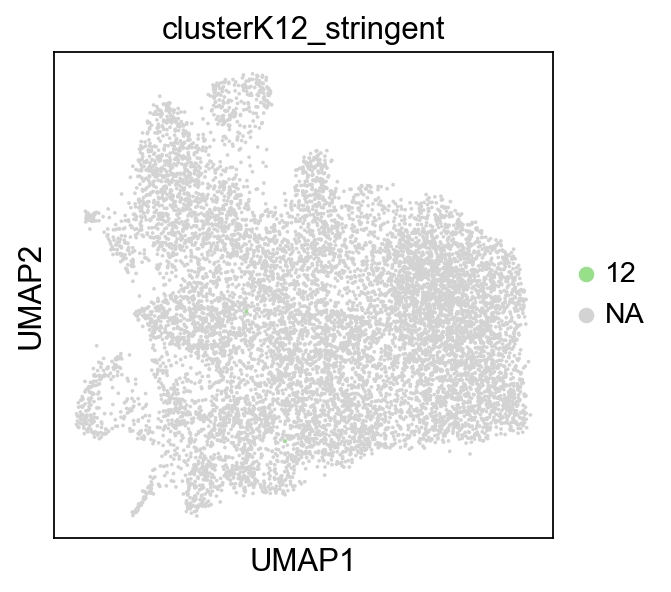

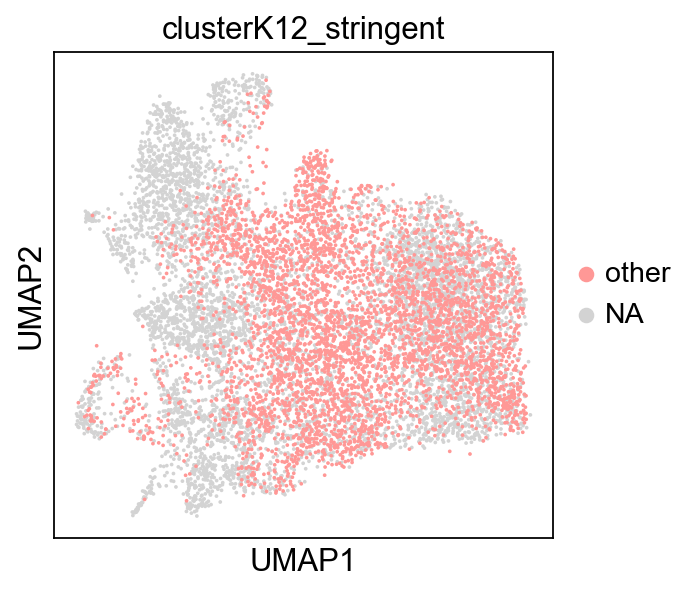

In [82]:
for x in adata_log_ordered.obs.clusterK12_stringent.cat.categories:
    # skip if NA
    sc.pl.umap(adata_log_ordered, color='clusterK12_stringent', groups=[x])

In [83]:
cancerCell = ['Cluster 1', 'Cluster 2','Cluster 3','Cluster 4','Cluster 5','Cluster 6', 'Cluster 7', 
              'Cluster 8', 'Cluster 9', 'Cluster 10', 'Cluster 11', 'Cluster 12']

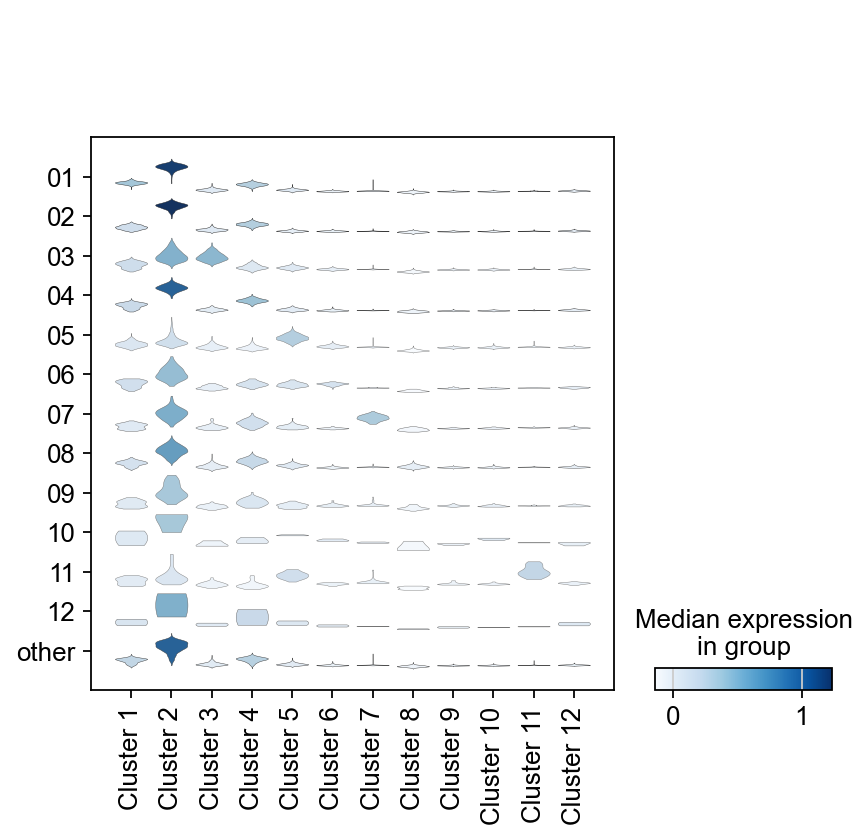

In [84]:
sc.pl.stacked_violin(adata_log_ordered, cancerCell, groupby='clusterK12_stringent')

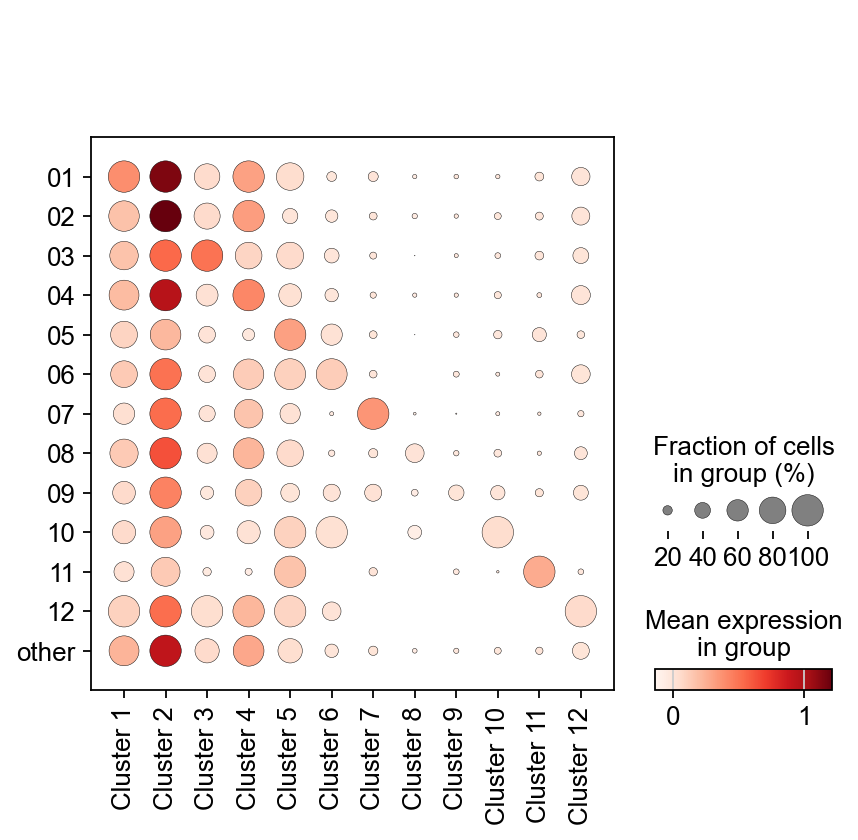

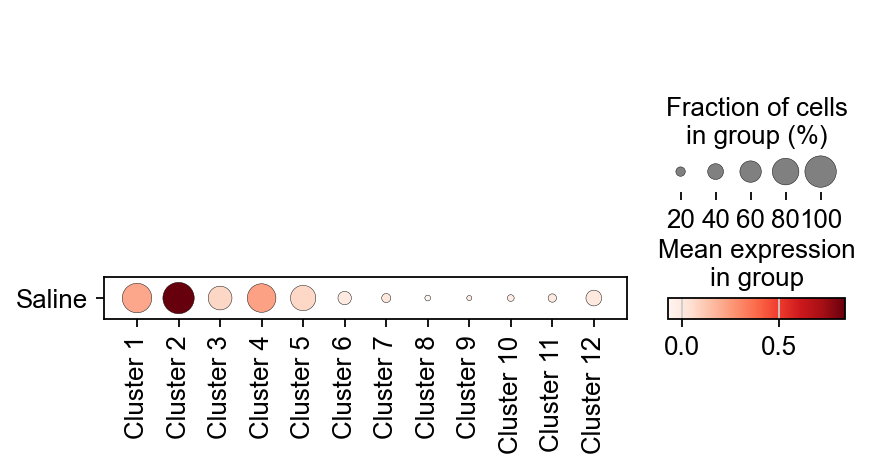

In [85]:
sc.pl.dotplot(adata_log_ordered, [*cancerCell], groupby='clusterK12_stringent')
sc.pl.dotplot(adata_log_ordered, [*cancerCell], groupby='Group')

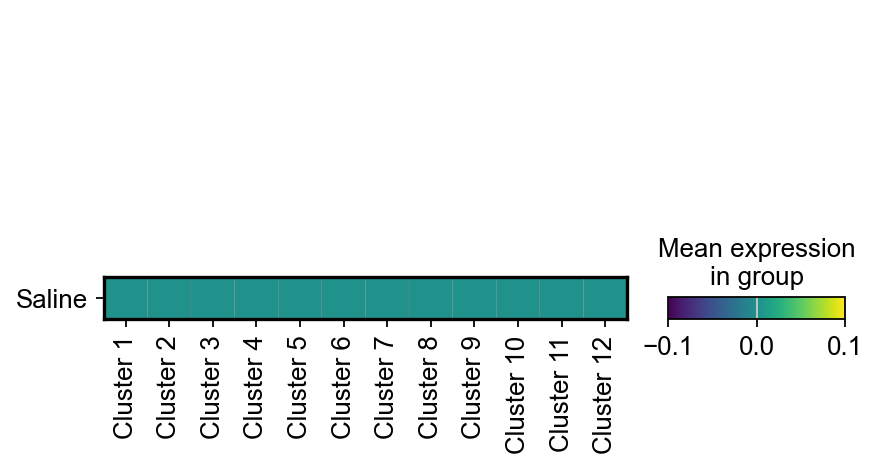

In [86]:
sc.pl.matrixplot(adata_log_ordered, [*cancerCell], groupby='Group',standard_scale='var')
#sc.pl.matrixplot(adata_log_ordered, cancerCell, groupby='Group',standard_scale='var')

In [87]:
adata.obs['clusterK12'] = adata_log_ordered.obs['clusterK12'].astype('category')
adata.obs['clusterK12_stringent'] = adata_log_ordered.obs['clusterK12_stringent'].astype('category')

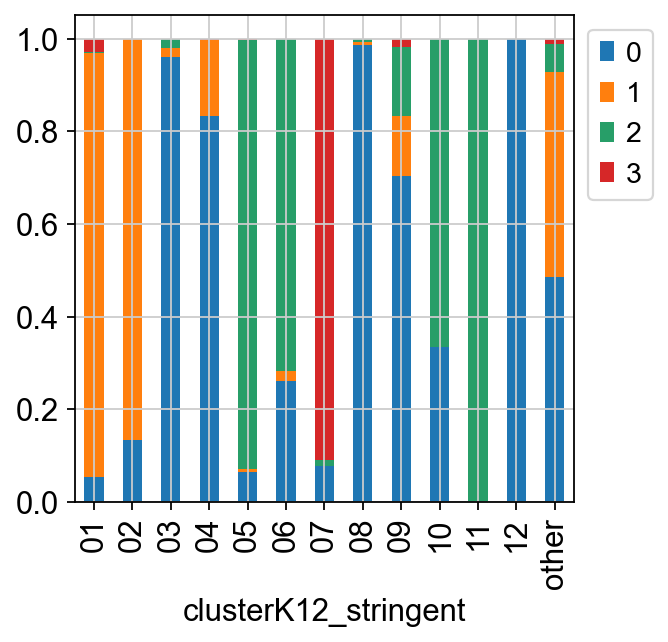

In [88]:
 cell_proportion_df = pd.crosstab(adata.obs['leiden'],adata_log_ordered.obs['clusterK12_stringent'], normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

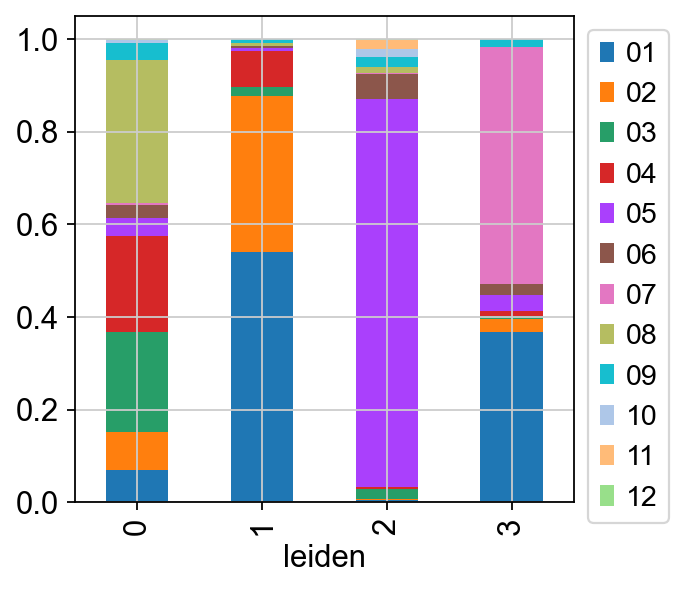

In [89]:
 cell_proportion_df = pd.crosstab(adata.obs['clusterK12'],adata_log_ordered.obs['leiden'], normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

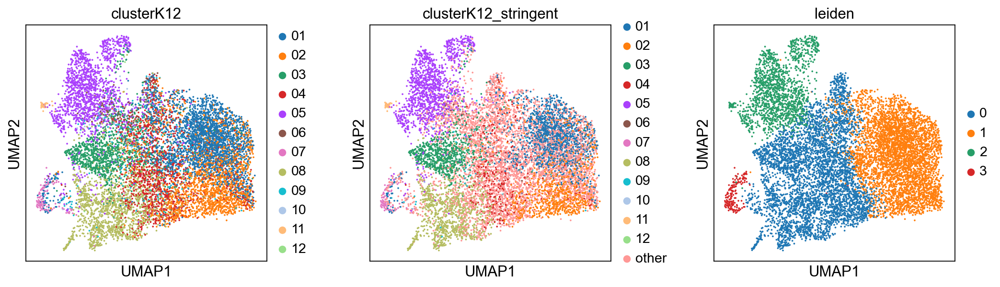

In [90]:
sc.pl.umap(adata, color=['clusterK12', 'clusterK12_stringent','leiden'], wspace=0.3)

## Evaluate clustering Leiden resoution=0.5

running Leiden clustering
    finished: found 9 clusters and added
    'newleiden', the cluster labels (adata.obs, categorical) (0:00:00)


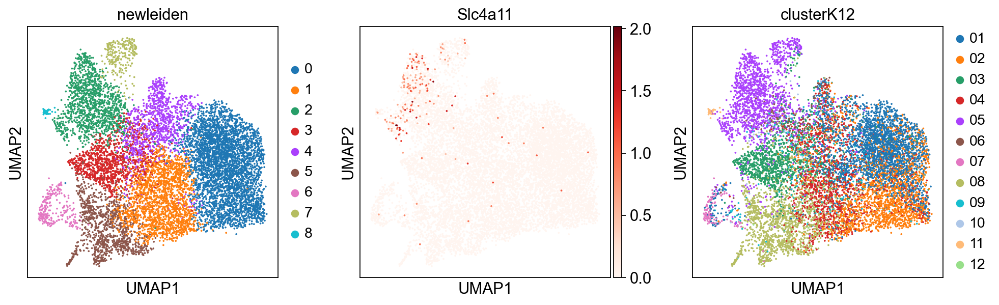

In [91]:
sc.tl.leiden(adata, resolution=.5, key_added='newleiden')
sc.pl.umap(adata, color=['newleiden','Slc4a11','clusterK12'], cmap='Reds')

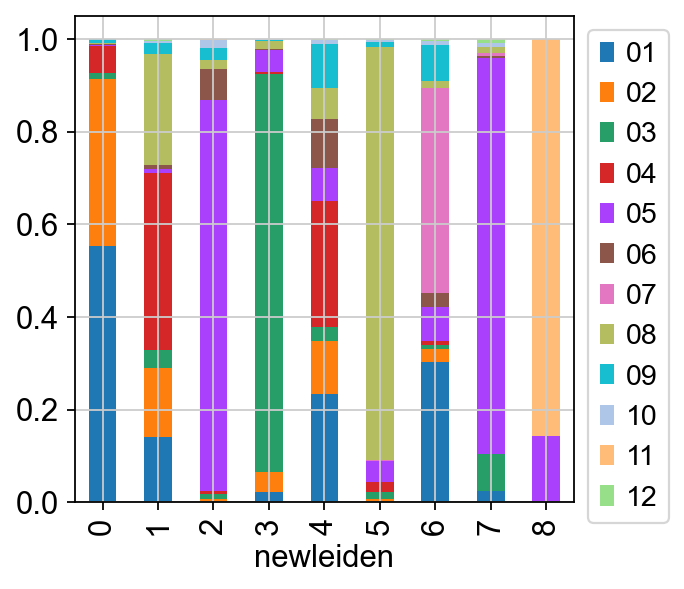

In [92]:
 cell_proportion_df = pd.crosstab(adata.obs['clusterK12'],adata.obs['newleiden'], normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

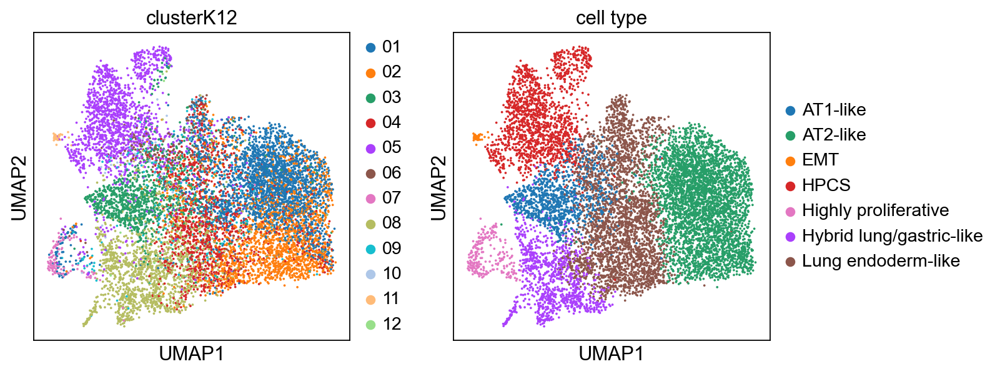

In [93]:
cluster2annotation = {
    "0": "AT2-like",
    "1": "Lung endoderm-like",
    "2": "HPCS",
    "3": "AT1-like",
    "4": "Lung endoderm-like",
    "5": "Hybrid lung/gastric-like",
    "6": "Highly proliferative",
    "7": "HPCS",
    "8": "EMT",
}
adata.obs["cell type"] = adata.obs["newleiden"].map(cluster2annotation).astype("category")
#adata.obs['cell type'].cat.categories
adata.obs['cell type'].cat.reorder_categories(new_categories=['AT1-like', 'AT2-like', 'EMT', 'Hybrid lung/gastric-like', 'HPCS',
                                                              'Highly proliferative', 'Lung endoderm-like'])
adata.uns['cell type_colors'] = ['#1f77b4','#279e68','#ff7f0e', '#d62728','#e377c2','#aa40fc','#8c564b']
sc.pl.umap(adata, color=['clusterK12','cell type'])

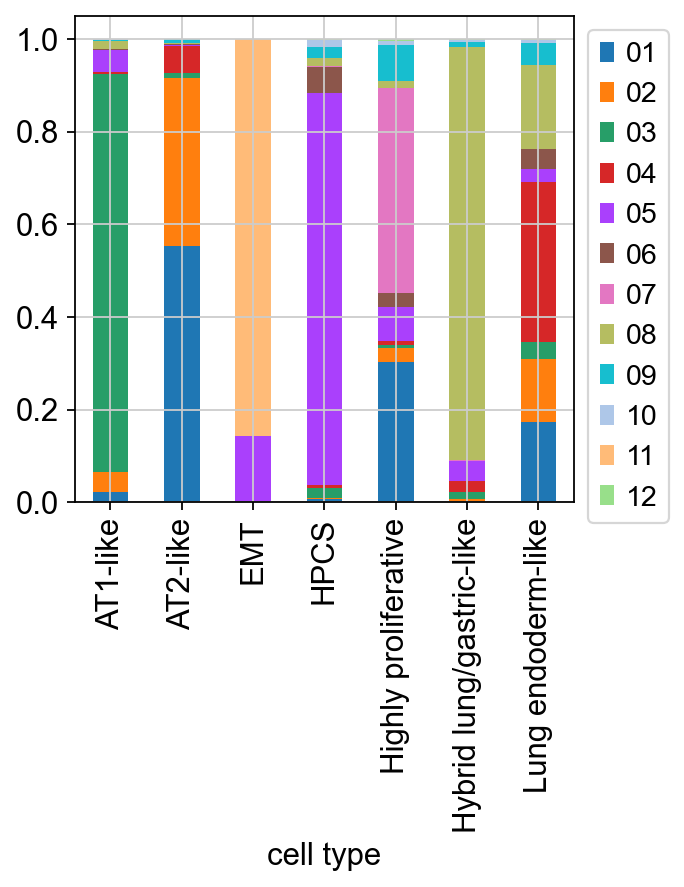

In [94]:
# Compare cancer cell to annotated leiden clusters
cell_proportion_df = pd.crosstab(adata.obs['clusterK12'],adata.obs['cell type'], normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

## Figures for the Paper

In [95]:
from matplotlib import cm
from matplotlib.colors import ListedColormap, LinearSegmentedColormap

# generate colormap
lightgray_red = LinearSegmentedColormap.from_list('red_grey', ['lightgray','red'], N=1000)

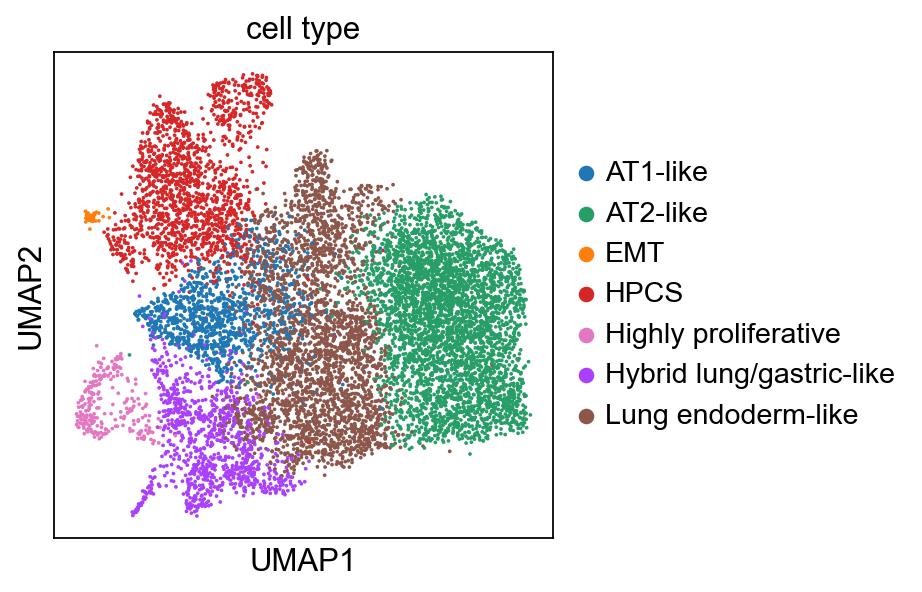

In [96]:
sc.pl.umap(adata, color=['cell type'],save='ExtData_Fig4e_umap.svg')

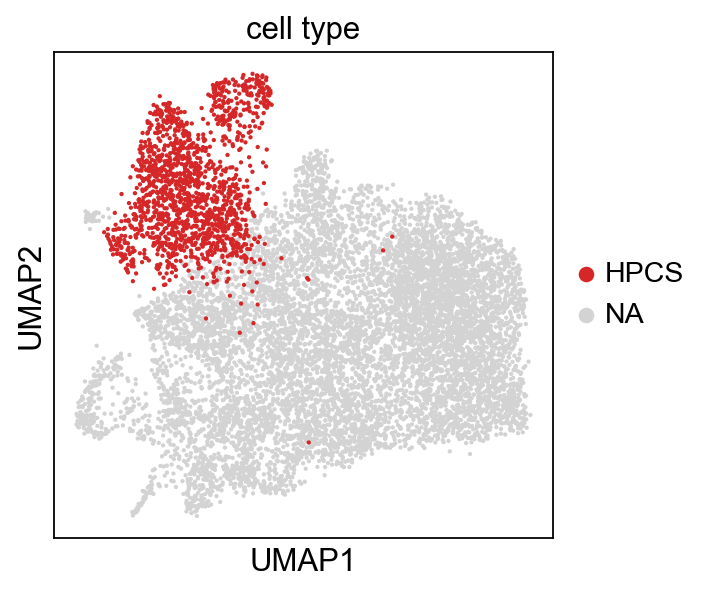

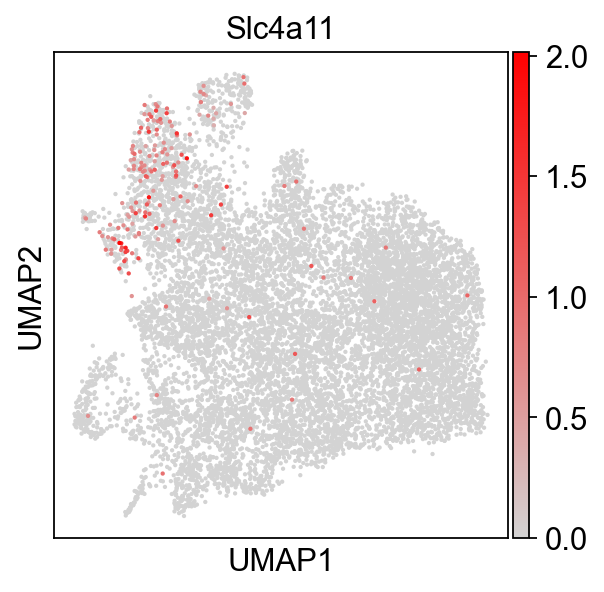

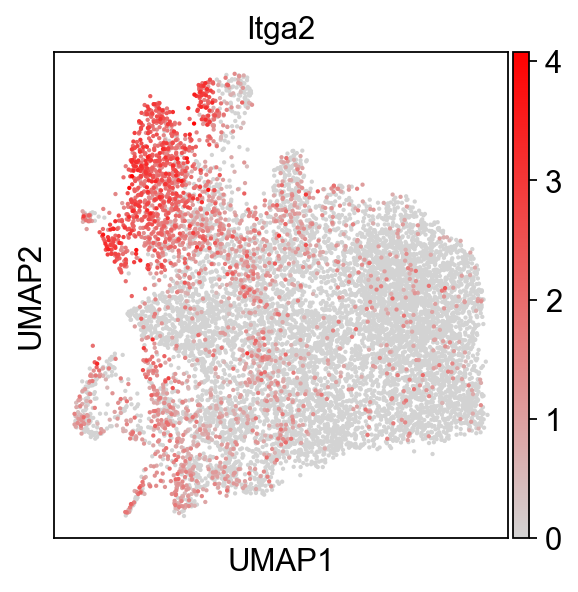

In [97]:
#HPCS and marker genes
sc.pl.umap(adata, color=['cell type'],save='ExtData_Fig4f_HPCS.svg',groups=['HPCS'],size=15)
sc.pl.umap(adata, color=['Slc4a11'],save='ExtData_Fig4g_Slc4a11.svg',cmap=lightgray_red,size=15)
sc.pl.umap(adata, color=['Itga2'],save='ExtData_Fig4g_Itga2.svg',cmap=lightgray_red,size=15)

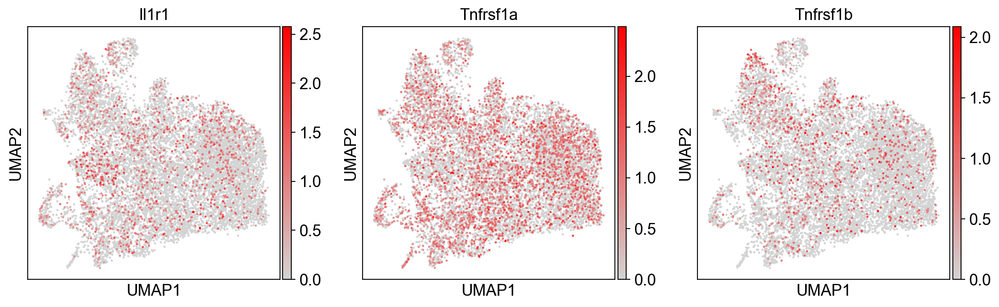

In [98]:
#Nfkb receptors
sc.pl.umap(adata, color=['Il1r1','Tnfrsf1a','Tnfrsf1b'],save='ExtData_Fig4h_Nfkb_receptors.svg',cmap=lightgray_red,size=15)
#sc.pl.umap(adata, color=['Tnfrsf1a'],save='ExtData_Fig4c_Slc4a11.svg',cmap=lightgray_red,size=15)
#sc.pl.umap(adata, color=['Tnf4sf1b'],save='ExtData_Fig4d_Itga2.svg',cmap=lightgray_red,size=15)

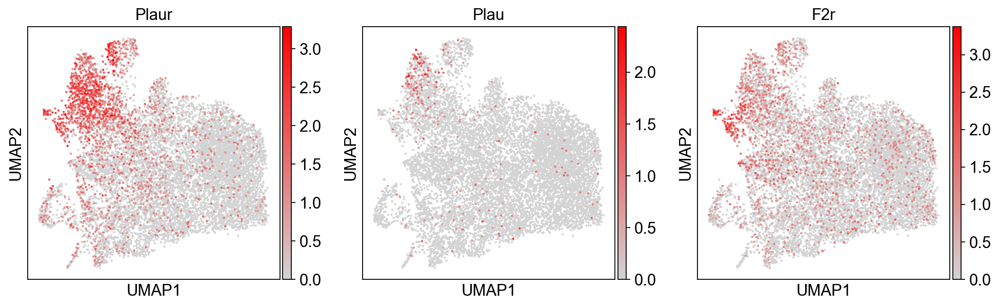

In [99]:
#uPAR PAR1 receptor & ligands
sc.pl.umap(adata, color=['Plaur','Plau','F2r'],save='ExtData_Fig5d_uPar_Par1.svg',cmap=lightgray_red,size=15) #,'Plat'

In [100]:
adata.obs['cell type'].value_counts()

cell type
AT2-like                    3810
Lung endoderm-like          2982
HPCS                        1533
AT1-like                    1072
Hybrid lung/gastric-like     984
Highly proliferative         244
EMT                           35
Name: count, dtype: int64

In [101]:
categories_order = ['AT2-like', 'AT1-like', 'Lung endoderm-like', 'HPCS','Highly proliferative','Hybrid lung/gastric-like','EMT']
categories_order_noEMT = ['AT2-like', 'AT1-like', 'Lung endoderm-like', 'HPCS','Highly proliferative','Hybrid lung/gastric-like'] #drop EMT given it has < 50 cells

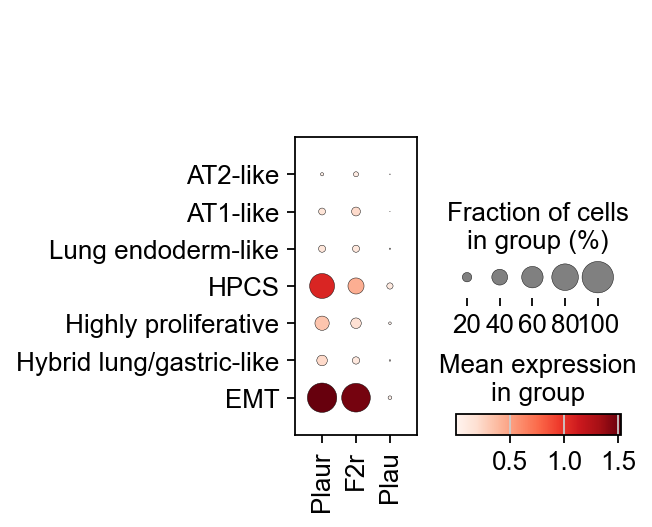

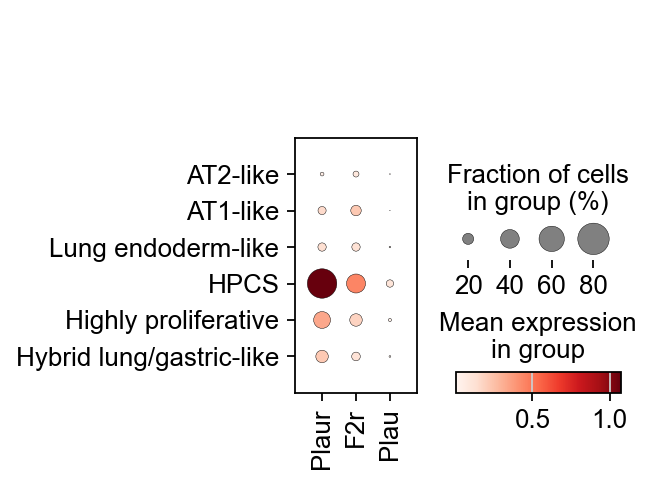

In [102]:
sc.pl.dotplot(adata, ['Plaur','F2r','Plau'], groupby='cell type', swap_axes=False,categories_order=categories_order, save='Fig2c_cellstates_genes.svg') #,'Plat'
sc.pl.dotplot(adata[~adata.obs['cell type'].isin(['EMT']),:], ['Plaur','F2r','Plau'], groupby='cell type', swap_axes=False,categories_order=categories_order_noEMT, save='Fig2c_cellstates_genes_notEMT.svg') #,'Plat'